## Lets get started..
**Import relevent libraries and check Python version**
We have tested with Python Version: 3.6.3

In [1]:
%matplotlib inline

from Resources import helpers
import matplotlib.pyplot as plt
import numpy as np
import scipy as sp
import pandas as pd
import pysal as ps
import geopandas as gpd
import shapefile
# You may need palettable: pip install palettable
from osgeo import ogr #dont use pip, but instead 'conda install gdal'
from pylab import *
import sys
import platform
import zipfile
import os
from datetime import datetime

from mpl_toolkits.basemap import Basemap 
# conda install -c conda-forge basemap 
# conda install -c conda-forge basemap-data-hires
from lxml import etree
import matplotlib.cm as cm
from matplotlib.colors import Normalize
from matplotlib.collections import PatchCollection
from shapely.geometry import Point, Polygon, MultiPoint, MultiPolygon
from shapely.prepared import prep
from pysal.esda.mapclassify import Natural_Breaks as nb
from descartes import PolygonPatch
import fiona
from itertools import chain
import pickle
from descartes import PolygonPatch

print(sys.version_info)
print("Python Version: " + str(platform.python_version()))

sys.version_info(major=3, minor=6, micro=4, releaselevel='final', serial=0)
Python Version: 3.6.4


In [2]:
clean_link = "./Data/nyc_census_tract_features_v3_export_clean"
clean_shp_link = clean_link + ".shp"

fiona_shp = fiona.open(clean_shp_link)
bds = fiona_shp.bounds
fiona_shp.close()
extra = 0.01
ll = (bds[0], bds[1])
ur = (bds[2], bds[3])
coords = list(chain(ll, ur))
w, h = coords[2] - coords[0], coords[3] - coords[1]
pickle_map_name = 'map.pickle'
map = Basemap(resolution='c', # c, l, i, h, f or None
                projection='tmerc',
                lat_0=40.655198,
                lon_0=-74.030345,
                ellps = 'WGS84',
                epsg=3627,
                llcrnrlon=coords[0] - extra * w,
                llcrnrlat=coords[1] - extra + 0.01 * h,
                urcrnrlon=coords[2] + extra * w,
                urcrnrlat=coords[3] + extra + 0.01 * h,)
pickle.dump(map,open(pickle_map_name,'wb'),-1)  # pickle it 

**Lets unzip the data!**

In [3]:
cwd = os.getcwd()  # Get the current working directory (cwd)
files = os.listdir(cwd)  # Get all the files in that directory
print("Files in '%s': %s" % (cwd, files))

Files in '/Users/bryder/polybox/PhD/Workshop/Spatial-Workshop': ['.DS_Store', 'Tutorial-Master.ipynb', 'Resources', 'Tutorial-Skeleton.ipynb', 'README.md', 'map.pickle', '.gitattributes', '.ipynb_checkpoints', '.git', 'Data', 'Spatial-Data.zip']


In [4]:
with zipfile.ZipFile("./Spatial-Data.zip","r") as zip_ref:
    zip_ref.extractall()

**Set some useful parameters**

In [5]:
# Some useful parameters that we don't need to set later
params = {'legend.fontsize': 20}
plt.rcParams.update(params)
tfs = 20

**And lets define some useful functions which are needed later**

In [6]:
# plotNeighborGraph: Plot maps wiith neighbor links
def plotNeighborGraph(title, grouping):
    f, ax = plt.subplots(1, figsize=(20, 20))
    dataset.plot(ax=ax, linewidth=0.5, color='white', edgecolor='black')
    plt.plot(centroids[:,0], centroids[:,1],'.')
    for k,neighs in grouping.neighbors.items():
        origin = centroids[k]
        for neigh in neighs:
            segment = centroids[[k,neigh]]
            plt.plot(segment[:,0], segment[:,1], '-')
    plt.title(title, fontsize=tfs)
    ax.set_axis_off()
    show()
    
# analyse_and_transform_wrapper: analyse_and_transform normalises variables with BoxCox
# this function wraps around to use with multiple values  
def analyse_and_transform_wrapper(names,data):
    for n in names:
        data[n] = helpers.analyse_and_transform(data[n])
    return data

## Data
**We need to import the data that we're using - this should be included in the git project**

In [7]:
shp_link = "./Data/nyc_census_tract_features_v3_export.shp"
dataset = gpd.read_file(shp_link)

# Interested to see the data? Uncomment and run the command below
#dataset

# Interested in the full list of variables? Uncomment and run the command below
#dataset.columns.tolist()

**Lets see what area this data looks like!**

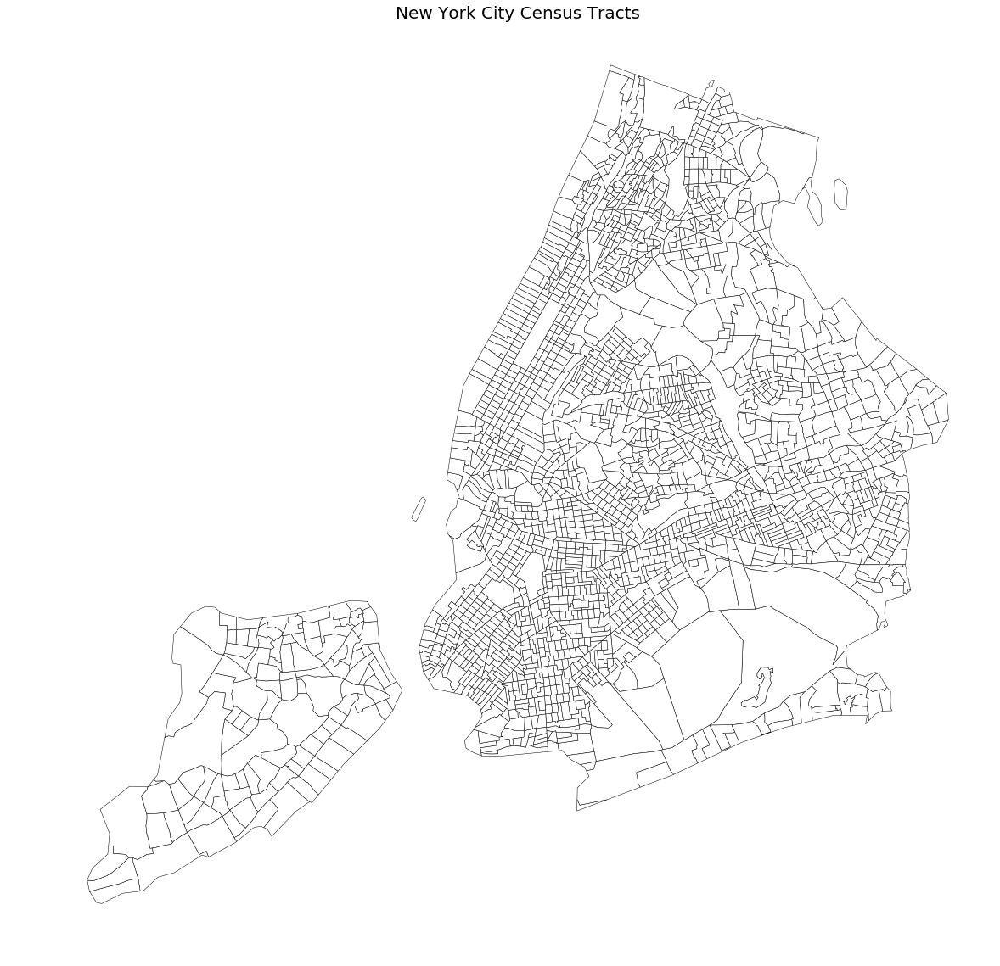

In [8]:
f, ax = plt.subplots(1, figsize=(20, 20))
dataset.plot(ax=ax, linewidth=0.5, color='white', edgecolor='black')
plt.title('New York City Census Tracts', fontsize=tfs)
ax.set_axis_off()
plt.show()

**Great, we have a visualisation of the census tracts in New York! Now lets take a look at the distribution of our dependent variable, average AirBnB price per night, for each of these tracts:**

{'boxes': [<matplotlib.lines.Line2D at 0x1a1bce9e80>],
 'caps': [<matplotlib.lines.Line2D at 0x1a1bcde860>,
 'fliers': [<matplotlib.lines.Line2D at 0x1a1bd9e748>],
 'means': [],
 'medians': [<matplotlib.lines.Line2D at 0x1a1bd9e5f8>],
 'whiskers': [<matplotlib.lines.Line2D at 0x1a1bce9cc0>,
  <matplotlib.lines.Line2D at 0x1a1bcde208>]}

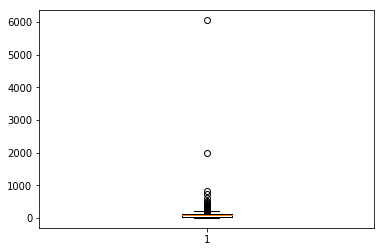

In [9]:
plt.boxplot(dataset.avg_listin, showfliers=True)

**There are some clear outliers, lets limit these to take a closer look**

{'boxes': [<matplotlib.lines.Line2D at 0x1a1bcad6a0>],
 'caps': [<matplotlib.lines.Line2D at 0x1a1aec4b70>,
 'fliers': [],
 'means': [],
 'medians': [<matplotlib.lines.Line2D at 0x1a1b9b70f0>],
 'whiskers': [<matplotlib.lines.Line2D at 0x1a1bcada90>,
  <matplotlib.lines.Line2D at 0x1a1aec44e0>]}

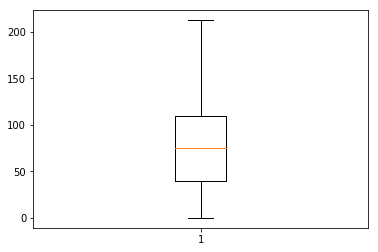

In [10]:
plt.boxplot(dataset.avg_listin, showfliers=False)

**Interestingly, we see here that there are some census tracts which have an average price per night of $0, this is probably a data quality issue.. so lets compare this to the number of listings per tract.**

In [11]:
error_tracts = dataset[dataset.avg_listin == 0]
print("Max Number of AirBnB Listings: " + str(max(error_tracts.count_list)))
print("Min Number of AirBnB Listings: " + str(min(error_tracts.count_list)))

Max Number of AirBnB Listings: 0.0
Min Number of AirBnB Listings: 0.0


**So we observe that there are some tracts which don't have any AirBnB listings, in these cases the price per night in the dataset is 0. In some cases it might be acceptable to include these tracts in the analysis, but in our case it will appear that some areas are free to stay in - where as the reality is that there are no places available.**

**Lets clean this dataset up!**

In [237]:
# Remove locations where there are no AirBnb listings

dataset_clean = dataset[dataset.count_list != 0]
#dataset_clean = dataset[(dataset.count_list != 0) & (dataset.geom_id == 1439)]

# lets chekc what the distribution looks like now:
#plt.boxplot(dataset_clean.avg_listin, showfliers=False)


**Much better! So that we can align this dataset to a map of New York lets convert the projection to include longitude and latitude coordinates, and then save the file to be reused later: **

In [238]:
dataset[(dataset.count_list != 0) & (dataset.geom_id == 1439)]

,geom_id,id,county,tract,geom_gps,locations_,incidents_,incident_1,larcenies_,robberies_,...,mta_we_mor,mta_week_m,max_qscore,min_qscore,avg_qscore,count_list,max_listin,min_listin,avg_listin,geometry
1059,1439,2507,5,51600,SRID=4326;MULTIPOLYGON(((-73.7655428263918 40....,101.0,354.0,152.0,53.0,12.0,...,,,0.0,0.0,0.0,4.0,125.0,69.0,104.5,(POLYGON ((1049108.969244379 250969.9278313242...


In [239]:
dataset_clean[(dataset_clean.count_list != 0) & (dataset_clean.geom_id == 1439)]

,geom_id,id,county,tract,geom_gps,locations_,incidents_,incident_1,larcenies_,robberies_,...,mta_we_mor,mta_week_m,max_qscore,min_qscore,avg_qscore,count_list,max_listin,min_listin,avg_listin,geometry
1059,1439,2507,5,51600,SRID=4326;MULTIPOLYGON(((-73.7655428263918 40....,101.0,354.0,152.0,53.0,12.0,...,,,0.0,0.0,0.0,4.0,125.0,69.0,104.5,(POLYGON ((1049108.969244379 250969.9278313242...


In [240]:
print(len(dataset_clean.avg_listin))
print(dataset_clean.avg_listin[1059])

1684
104.5


In [241]:


map = Basemap(resolution='c', # c, l, i, h, f or None
                projection='tmerc',
                lat_0=40.655198,
                lon_0=-74.030345,
                ellps = 'WGS84',
                epsg=3627,
                llcrnrlon=coords[0] - extra * w,
                llcrnrlat=coords[1] - extra + 0.01 * h,
                urcrnrlon=coords[2] + extra * w,
                urcrnrlat=coords[3] + extra + 0.01 * h,)
pickle.dump(map,open(pickle_map_name,'wb'),-1)  # pickle it 

In [242]:
test = dataset_clean.avg_listin.copy()
test = test.tolist()
print(len(test))
test[1687]

1684


IndexError: list index out of range

In [ ]:
dataset_clean

In [245]:
# We convert the dataset to lon-lat projection
dataset_clean = dataset_clean.to_crs({'proj':'longlat', 'ellps':'WGS84'})

# Save the clean dataset to a new file for reuse later
clean_link = "./Data/nyc_census_tract_features_v3_export_clean"
clean_shp_link = clean_link + ".shp"

dataset_clean.to_file(clean_shp_link, driver='ESRI Shapefile')

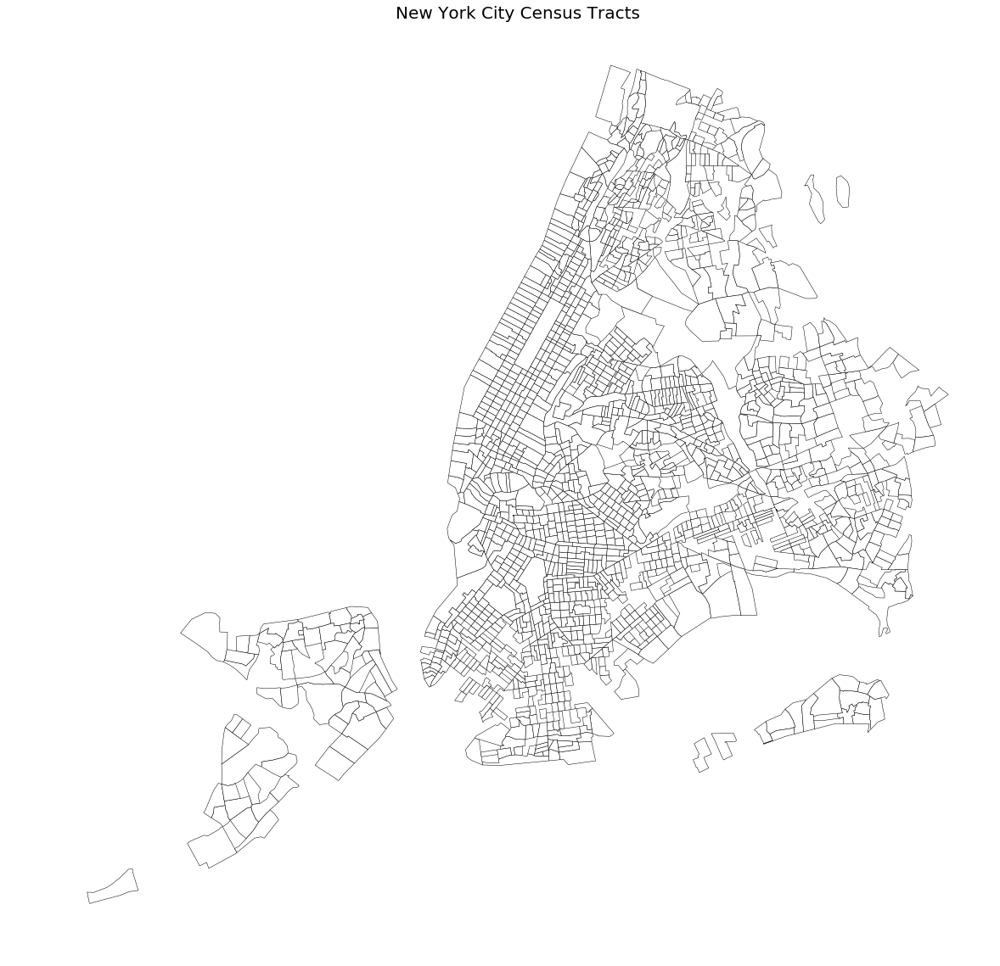

In [244]:
f, ax = plt.subplots(1, figsize=(20, 20))
dataset_clean.plot(ax=ax, linewidth=0.5, color='white', edgecolor='black')
plt.title('New York City Census Tracts', fontsize=tfs)
ax.set_axis_off()
plt.show()

** Plotting Data onto a Map **

In [16]:
fiona_shp = fiona.open(clean_shp_link)
bds = fiona_shp.bounds
fiona_shp.close()
extra = 0.01
ll = (bds[0], bds[1])
ur = (bds[2], bds[3])
coords = list(chain(ll, ur))
w, h = coords[2] - coords[0], coords[3] - coords[1]
pickle_map_name = 'map.pickle'
map = Basemap(resolution='c', # c, l, i, h, f or None
                projection='tmerc',
                lat_0=40.655198,
                lon_0=-74.030345,
                ellps = 'WGS84',
                epsg=3627,
                llcrnrlon=coords[0] - extra * w,
                llcrnrlat=coords[1] - extra + 0.01 * h,
                urcrnrlon=coords[2] + extra * w,
                urcrnrlat=coords[3] + extra + 0.01 * h,)
pickle.dump(map,open(pickle_map_name,'wb'),-1)  # pickle it 

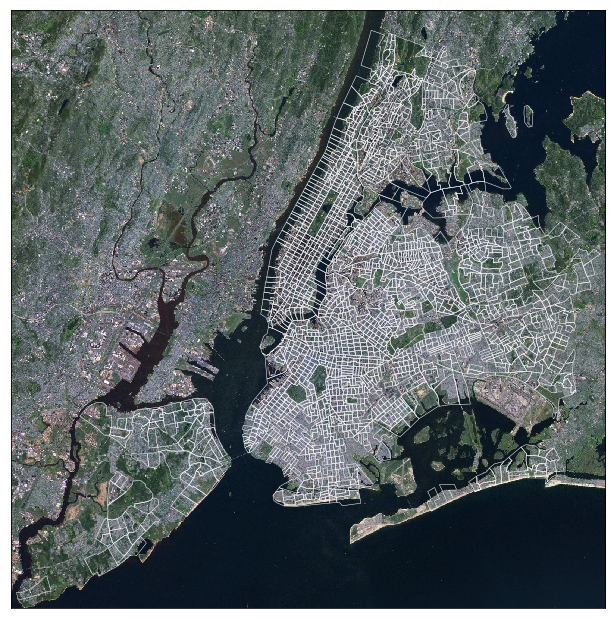

In [266]:
f, ax = plt.subplots(1, figsize=(11, 11))

map = pickle.load(open(pickle_map_name,'rb')) 

map.arcgisimage(service='ESRI_Imagery_World_2D', xpixels=1000, zorder=0)

map.readshapefile(name='tracts', shapefile=clean_link, linewidth=0.5, color='white', zorder=1)

plt.show()

In [247]:
print(len(map.tracts_info))

1685


In [286]:
def plotArcGisMap(variable, dataframe, cmap='YlOrRd'):
    f, ax = plt.subplots(1, figsize=(11, 11))
    
    map = pickle.load(open(pickle_map_name,'rb')) 
    map.arcgisimage(service='ESRI_Imagery_World_2D', xpixels=1000, zorder=0)

    patches = dataframe['poly'].map(lambda x: PolygonPatch(x, edgecolor='white', linewidth=0.75, zorder=10))
    patches = PatchCollection(patches, match_original=True, zorder=10)
    cmap = plt.get_cmap(cmap)
    norm = Normalize()

    # impose our colour map onto the patch collection
    patches.set_facecolor(cmap(norm(variable)))    
    patches.set_alpha(0.5)
    ax.add_collection(patches)

    plt.show()

In [292]:
map.readshapefile(name='tracts', 
                   shapefile=clean_link, 
                   linewidth=0.5, 
                   color='white', 
                   zorder=1, 
                   drawbounds=False)
map_tracts = map.tracts
map_tracts_info = map.tracts_info

In [294]:
map_tracts_info

[{'RINGNUM': 1,
  'SHAPENUM': 1,
  'age_index': 0.933534185200243,
  'area': 0.046227678982293,
  'asian_frac': 6.28,
  'asian_popu': 226.0,
  'assaults_1': 2206.4702845901,
  'assaults_2': 102.0,
  'assaults_3': 28.36,
  'avg_age': 33.1,
  'avg_househ': 2.34,
  'avg_listin': 97.8627450980392,
  'avg_qscore': 26.4182643797468,
  'black_frac': 60.75,
  'black_popu': 2185.0,
  'burglari_1': 1622.40462102213,
  'burglari_2': 20.85,
  'burglaries': 75.0,
  'checkins10': 0.081875140626893,
  'checkins11': 0.000675009086661,
  'checkins12': 2.15255196314098,
  'checkins_1': 78,
  'checkins_2': 0.004275057548852,
  'checkins_3': 0.001012513629991,
  'checkins_4': 0.0,
  'checkins_5': 0.593653183792859,
  'checkins_6': 0.279323952437821,
  'checkins_7': 0.010038596673417,
  'checkins_8': 0.015568478806446,
  'checkins_9': 0.013578067397061,
  'checkins_a': 494,
  'checkins_c': 117,
  'checkins_e': 0,
  'checkins_f': 68599,
  'checkins_i': 0.467001058761104,
  'checkins_n': 32277,
  'checkins_o

In [293]:
df_map = pd.DataFrame({
    'poly': [Polygon(xy) for xy in map_tracts],
    'id': [tract['id'] for tract in map_tracts_info],
    'avg_listin':[tract['avg_listin'] for tract in map_tracts_info]})

#df_map['patches'] = df_map['poly'].map(lambda x: PolygonPatch(x, edgecolor='white', linewidth=0.75, zorder=10))
#patches = PatchCollection(df_map['patches'], match_original=True, zorder=10)

1685
1685


(array([ 333.,  206.,  143.,  102.,  176.,  112.,  158.,  154.,  148.,  153.]),
 array([ 0. ,  0.9,  1.8,  2.7,  3.6,  4.5,  5.4,  6.3,  7.2,  8.1,  9. ]),
 <a list of 10 Patch objects>)

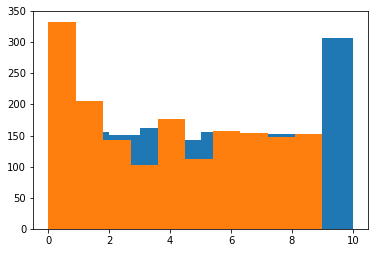

In [289]:
df_map_avg_listin = [tract['avg_listin'] for tract in map.tracts_info]
bin_n=10
avg_listin_quantiles = ps.Quantiles(df_map_avg_listin,k=bin_n+1)
print(len(avg_listin_quantiles.yb))
plt.hist(avg_listin_quantiles.yb)

df_map_count_list = [tract['count_list'] for tract in map.tracts_info]
bin_n=10
count_list_quantiles = ps.Quantiles(df_map_count_list,k=bin_n+1)
print(len(count_list_quantiles.yb))
plt.hist(count_list_quantiles.yb)

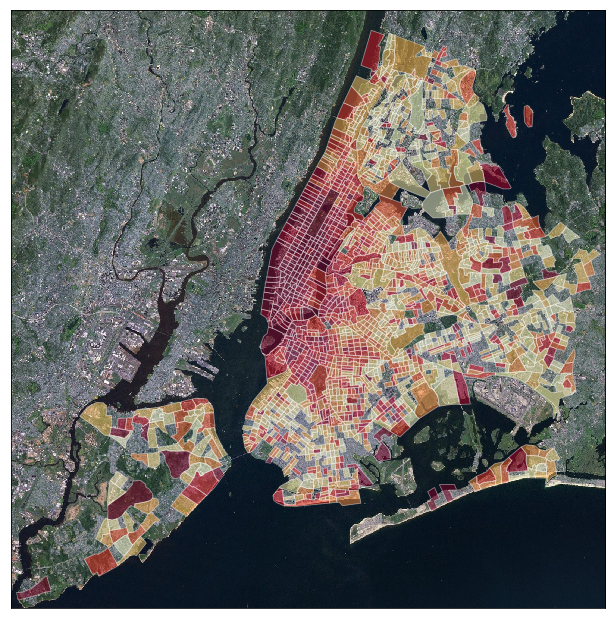

In [291]:
plotArcGisMap(avg_listin_quantiles.yb, df_map)

In [249]:
variable = dataset_clean.avg_listin.copy()
variable = variable.tolist()

ValueError: arrays must all be same length

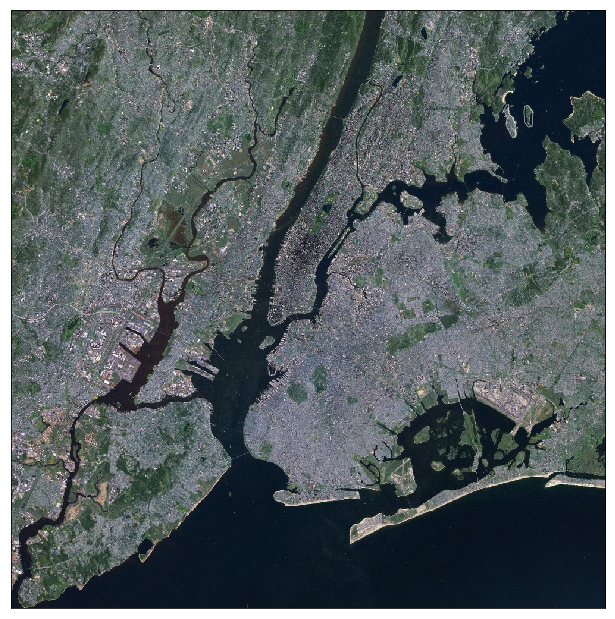

In [222]:
plotArcGisMap(df_map['avg_listin'].values)

ValueError: arrays must all be same length

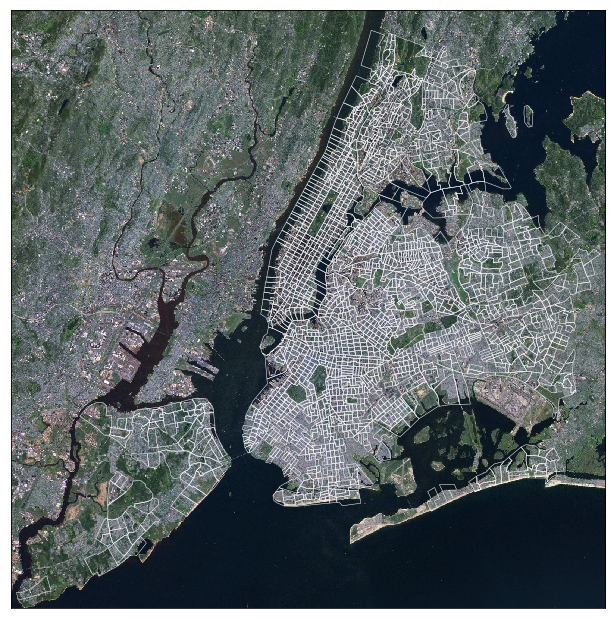

In [79]:


#plotArcGisMap(variable)
f, ax = plt.subplots(1, figsize=(11, 11))
map = pickle.load(open(pickle_map_name,'rb')) 
map.arcgisimage(service='ESRI_Imagery_World_2D', xpixels=1000, zorder=0)

map.readshapefile(name='tracts', shapefile=clean_link, linewidth=0.5, color='white', zorder=1)

df_map = pd.DataFrame({
    'poly': [Polygon(xy) for xy in map.tracts],
    'id': [tract['id'] for tract in map.tracts_info],
    'variable': [variable[i] for i in range(0,len(variable))]})

df_map['patches'] = df_map['poly'].map(lambda x: PolygonPatch(x, edgecolor='white', linewidth=0.75, zorder=10))
pc = PatchCollection(df_map['patches'], match_original=True, zorder=10)
pc.set_alpha(0.5)



# impose our colour map onto the patch collection
pc.set_facecolor(cmap(norm(df_map['variable'].values)))
cmap = plt.get_cmap(cmap)
norm = Normalize()
ax.add_collection(pc)

plt.show()

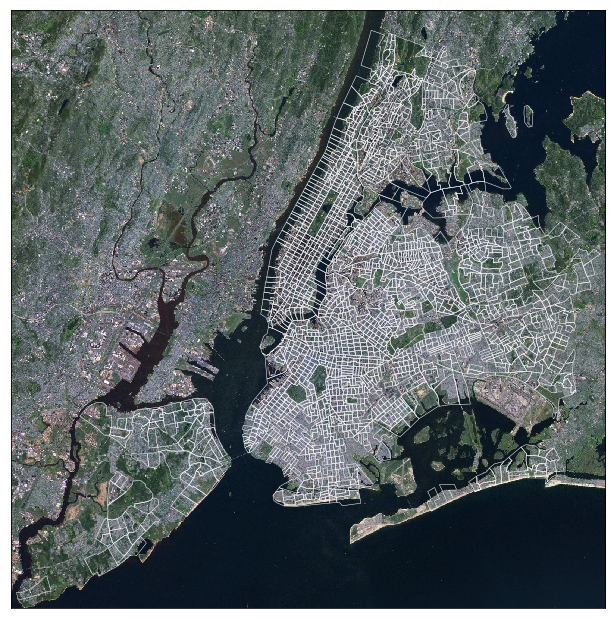

In [25]:
f, ax = plt.subplots(1, figsize=(11, 11))

map = pickle.load(open(pickle_map_name,'rb')) 

map.arcgisimage(service='ESRI_Imagery_World_2D', xpixels=1000, zorder=0)

map.readshapefile(name='tracts', shapefile=clean_link, linewidth=0.5, color='white', zorder=1)

plt.show()

In [ ]:
f, ax = plt.subplots(1, figsize=(11, 11))

map = pickle.load(open(pickle_map_name,'rb')) 
map.arcgisimage(service='ESRI_Imagery_World_2D', xpixels=1000, zorder=0)

map.readshapefile(name='tracts', shapefile=clean_link, linewidth=0, zorder=1)

df_map = pd.DataFrame({
    'poly': [Polygon(xy) for xy in map.tracts],
    'id': [tract['id'] for tract in map.tracts_info],
    'count_list_quantiles': [count_list_quantiles.yb[i] for i in range(0,len(count_list_quantiles.yb))],
    'avg_listin_quantiles': [avg_listin_quantiles.yb[i] for i in range(0,len(avg_listin_quantiles.yb))]})

#map.readshapefile(name='tracts', shapefile='./Data/geomapped', linewidth=0.5)
# use a blue colour ramp - we'll be converting it to a map using cmap()
cmap = plt.get_cmap('YlOrRd')
# draw wards with grey outlines
df_map['patches'] = df_map['poly'].map(lambda x: PolygonPatch(x, edgecolor='black', lw=0.75, zorder=10))
pc = PatchCollection(df_map['patches'], match_original=True, zorder=10)

# impose our colour map onto the patch collection
norm = Normalize()
pc.set_facecolor(cmap(norm(df_map['avg_listin_quantiles'].values)))
pc.set_alpha(0.5)
ax.add_collection(pc)

plt.show()

**Let's also generate the central points for each of these census tracts...**

In [27]:
dataframe_clean = ps.pdio.read_files(clean_shp_link)
centroids_clean = np.array([list(poly.centroid) for poly in dataframe_clean.geometry])

**... And display these on the same map as before**

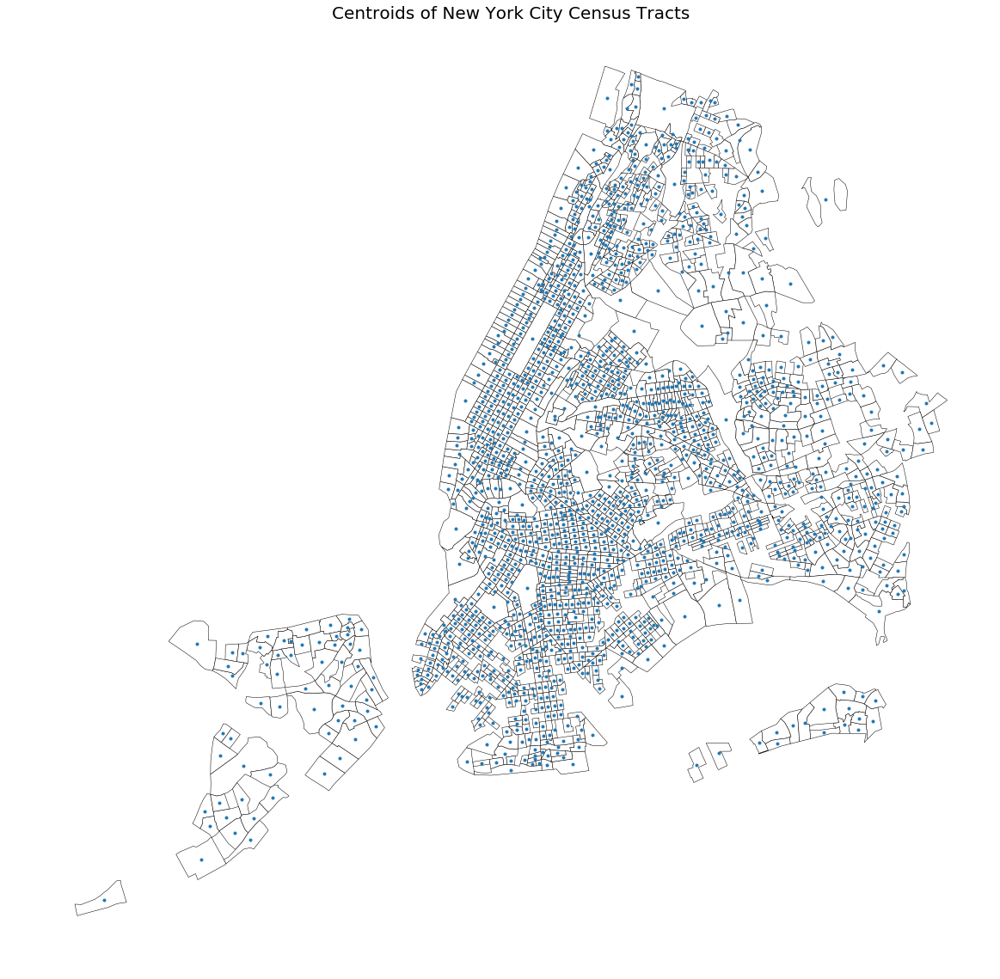

In [31]:
f, ax = plt.subplots(1, figsize=(20, 20))
dataset_clean.plot(ax=ax, linewidth=0.5, color='white', edgecolor='black')
plt.plot(centroids_clean[:,0], centroids_clean[:,1],'.')
plt.title('Centroids of New York City Census Tracts', fontsize=tfs)
ax.set_axis_off()
plt.show()

In [193]:
dataframe_clean = ps.pdio.read_files(clean_shp_file)
centroids_clean = np.array([list(poly.centroid) for poly in dataframe_clean.geometry])

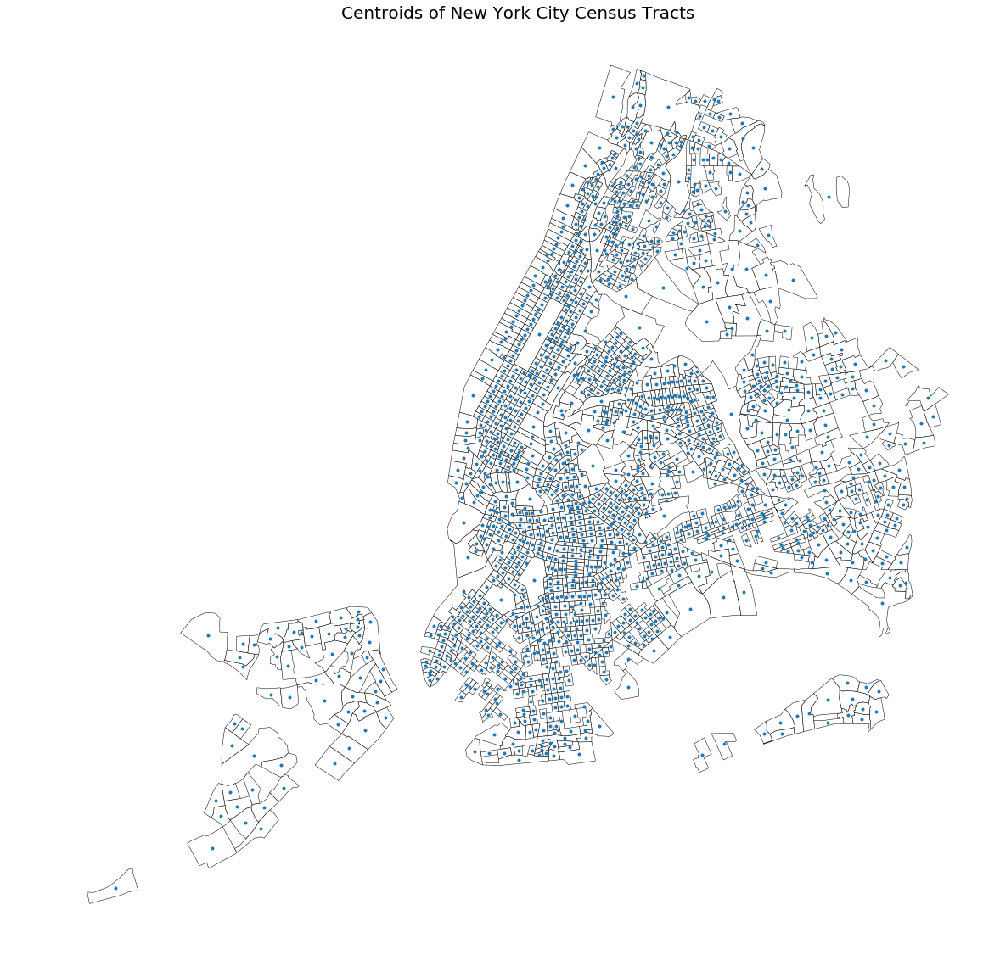

In [191]:
f, ax = plt.subplots(1, figsize=(20, 20))
dataset_clean.plot(ax=ax, linewidth=0.5, color='white', edgecolor='black')
plt.plot(centroids_clean[:,0], centroids_clean[:,1],'.')
plt.title('Centroids of New York City Census Tracts', fontsize=tfs)
ax.set_axis_off()
plt.show()

## Neighbors
**Neighbors can be defined in many ways, one of the simplest is to take the** 'K-nearest Neighbors' **of each centroid point**

**This is very easy with pysal and shapefiles!**

In [11]:
knn = ps.knnW_from_shapefile(shp_link, k=4)

# Interested to see the data? Uncomment and run the command below
#knn.neighbors

**To test this, we can take a single point, and link this with its neighbors**

In [50]:
self_and_neighbors = [0]
self_and_neighbors.extend(knn.neighbors[0])
print(self_and_neighbors)
dataset.loc[self_and_neighbors]

NameError: name 'knn' is not defined

**Lets use one of the predefined functions to visualise this to check how the linking looks**

2018-01-27 17:41:28.805156


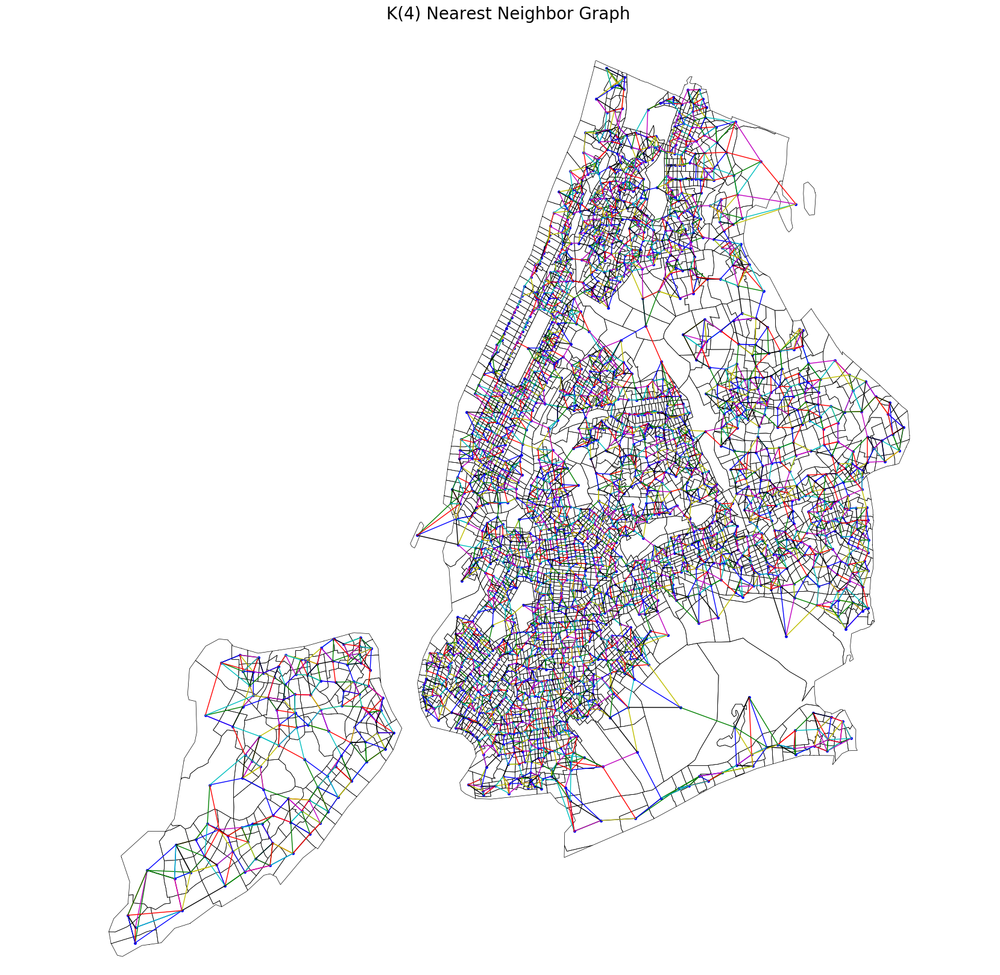

2018-01-27 17:41:50.901079


In [13]:
print(str(datetime.now()))

plotNeighborGraph('K(4) Nearest Neighbor Graph', knn)

print(str(datetime.now()))

**There are clearly some issues with this approach**

**Other techniques are more suitable when the map data is available**

**Queens Neighbors are those that share an edge OR a corner, and can also be easily generated from shapefiles** 

2018-01-27 17:41:50.906362
('Island id: ', [241])


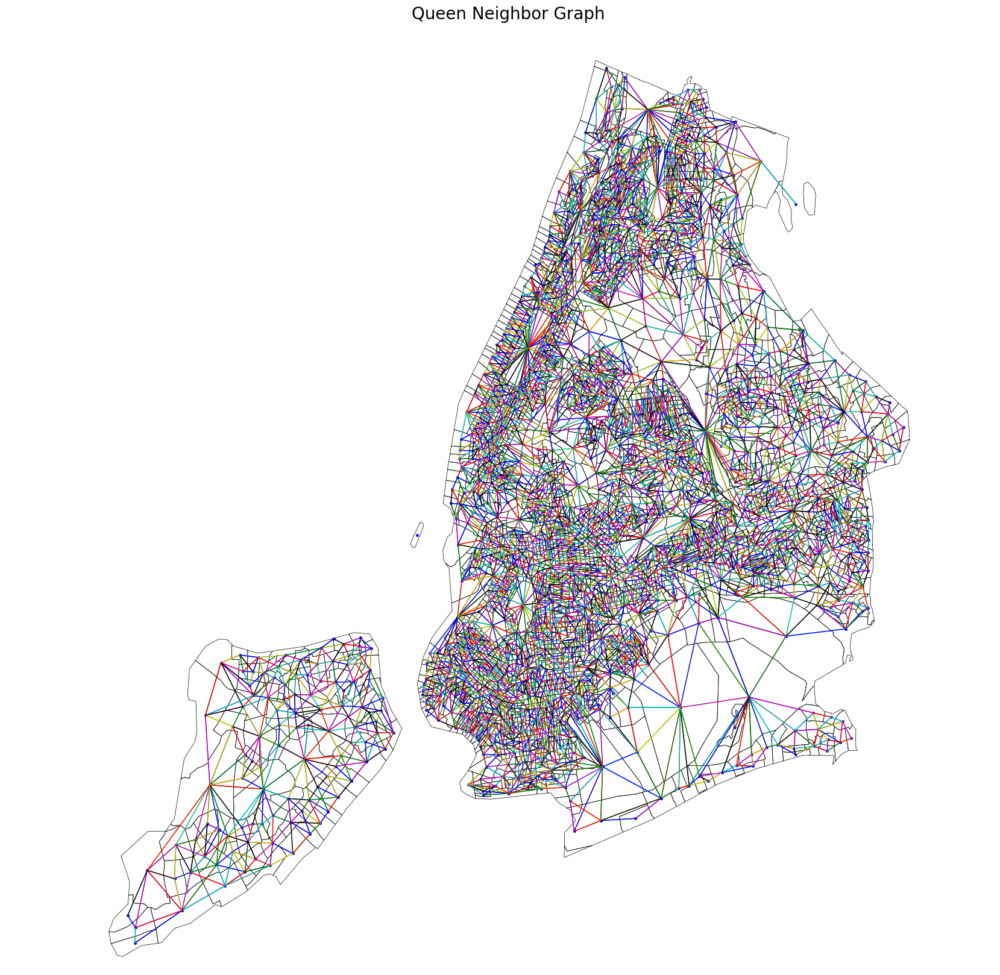

2018-01-27 17:42:20.992959


In [14]:
print(str(datetime.now()))

qW = ps.queen_from_shapefile(shp_link)
plotNeighborGraph('Queen Neighbor Graph', qW)

print(str(datetime.now()))

**This is much better, but perhaps overkill for our problem right now.**

**Especially as US census tracts are often 'grid' based.**

** Rook Neighbors are similar to Queens, but link only via edges (and not corners)**

**.. and can be generated in the same way as before**

2018-01-31 16:49:08.268527


/Users/bryder/anaconda3/lib/python3.6/site-packages/pysal/weights/weights.py:189: UserWarning: There are 8 disconnected observations
  warnings.warn("There are %d disconnected observations" % ni)
/Users/bryder/anaconda3/lib/python3.6/site-packages/pysal/weights/weights.py:190: UserWarning: Island ids: 245, 418, 429, 745, 813, 1179, 1366, 1538
  warnings.warn("Island ids: %s" % ', '.join(str(island) for island in self.islands))


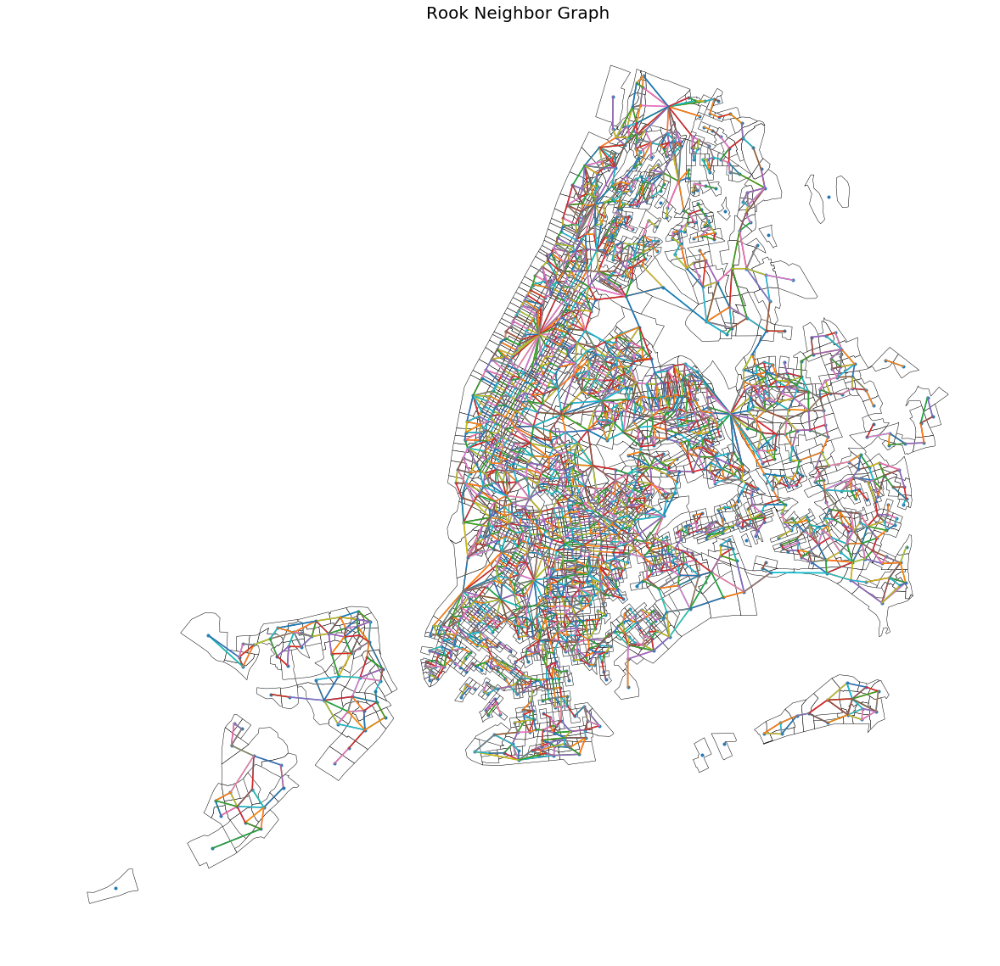

2018-01-31 16:51:41.709996


In [44]:
print(str(datetime.now()))

rW = ps.rook_from_shapefile(clean_shp_file)
plotNeighborGraph('Rook Neighbor Graph', rW)

print(str(datetime.now()))

## Visualising the data

** So we have some neighbors, but what are we actually investigating here**

** Average AirBnB listing price in New York Census Tracts**

** Lets add this to our map!**

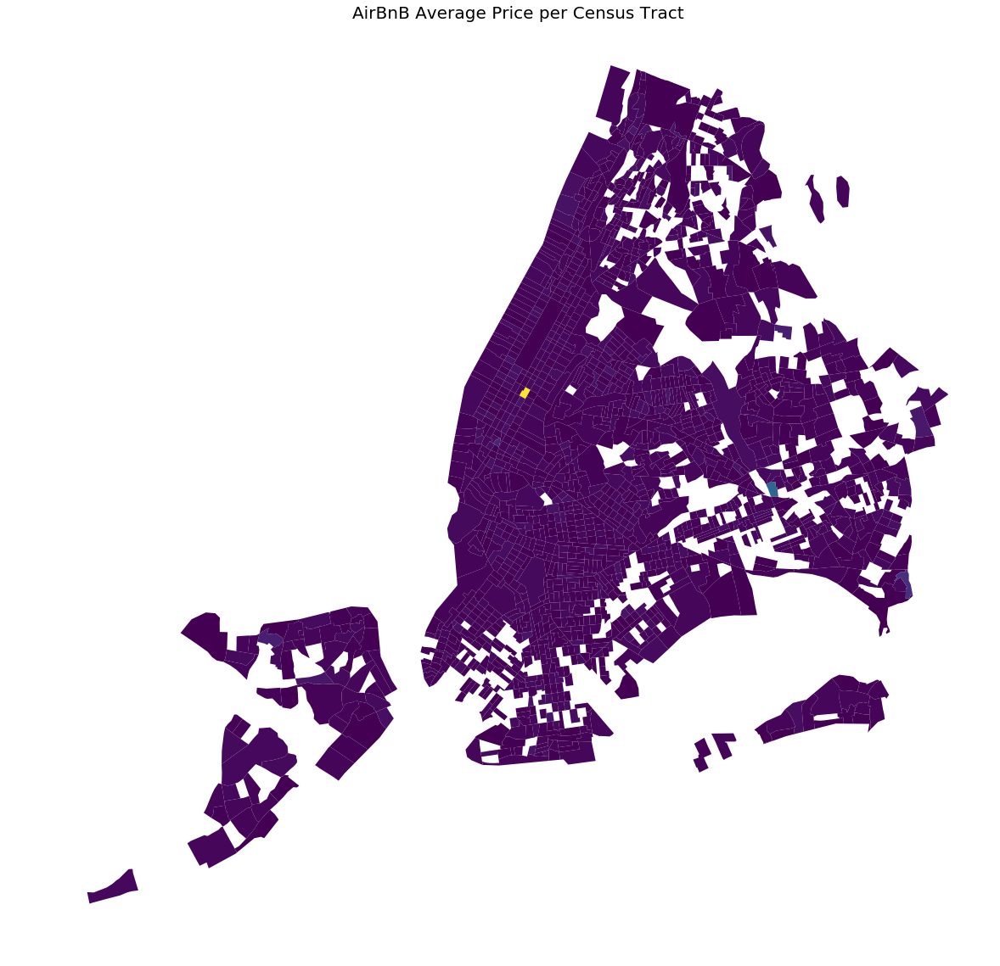

In [43]:
f, ax = plt.subplots(1, figsize=(20, 20))
dataset.plot(ax=ax, linewidth=0.5, column='avg_listin')
plt.title('AirBnB Average Price per Census Tract', fontsize=tfs)
ax.set_axis_off()
plt.show()

**Interesting, but not so useful for us to interpret really**

**We should take a closer look at the data**

{'boxes': [<matplotlib.lines.Line2D at 0x1a3442b4a8>],
 'caps': [<matplotlib.lines.Line2D at 0x1a3442bf28>,
 'fliers': [<matplotlib.lines.Line2D at 0x1a34436c88>],
 'means': [],
 'medians': [<matplotlib.lines.Line2D at 0x1a34436828>],
 'whiskers': [<matplotlib.lines.Line2D at 0x1a3442b630>,
  <matplotlib.lines.Line2D at 0x1a3442bac8>]}

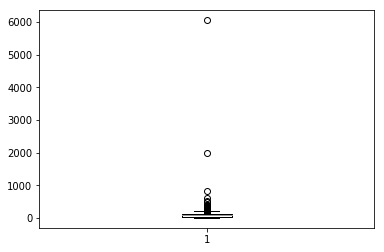

In [45]:
plt.boxplot(dataset.avg_listin, showfliers=True)

**There are some clear outliers**

{'boxes': [<matplotlib.lines.Line2D at 0x1a315ce390>],
 'caps': [<matplotlib.lines.Line2D at 0x1a33f7aa20>,
 'fliers': [],
 'means': [],
 'medians': [<matplotlib.lines.Line2D at 0x1a2103a3c8>],
 'whiskers': [<matplotlib.lines.Line2D at 0x1a315ce278>,
  <matplotlib.lines.Line2D at 0x1a33fc1f60>]}

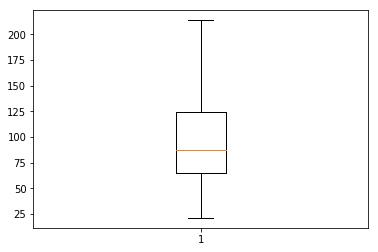

In [80]:
plt.boxplot(dataset_clean.avg_listin, showfliers=False)

**We can manage these outliers by calculating the quantiles of the data, and help us see patterns in the data**

In [99]:
print(len(dataset.avg_listin))
print(max(dataset.avg_listin))

2167
6050.0


(array([ 190.,  159.,  156.,  170.,  169.,  166.,  169.,  168.,  168.,  169.]),
 array([ 0. ,  0.9,  1.8,  2.7,  3.6,  4.5,  5.4,  6.3,  7.2,  8.1,  9. ]),
 <a list of 10 Patch objects>)

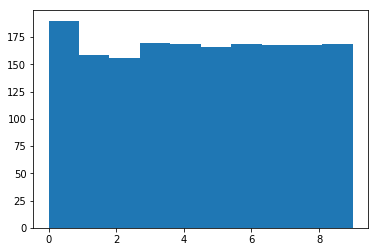

In [163]:
bin_n=9
quantiles = ps.Quantiles(dataset_clean.avg_listin,k=bin_n+1)
plt.hist(quantiles.yb)

**Let's see if this helps us interpret the data more easily..**

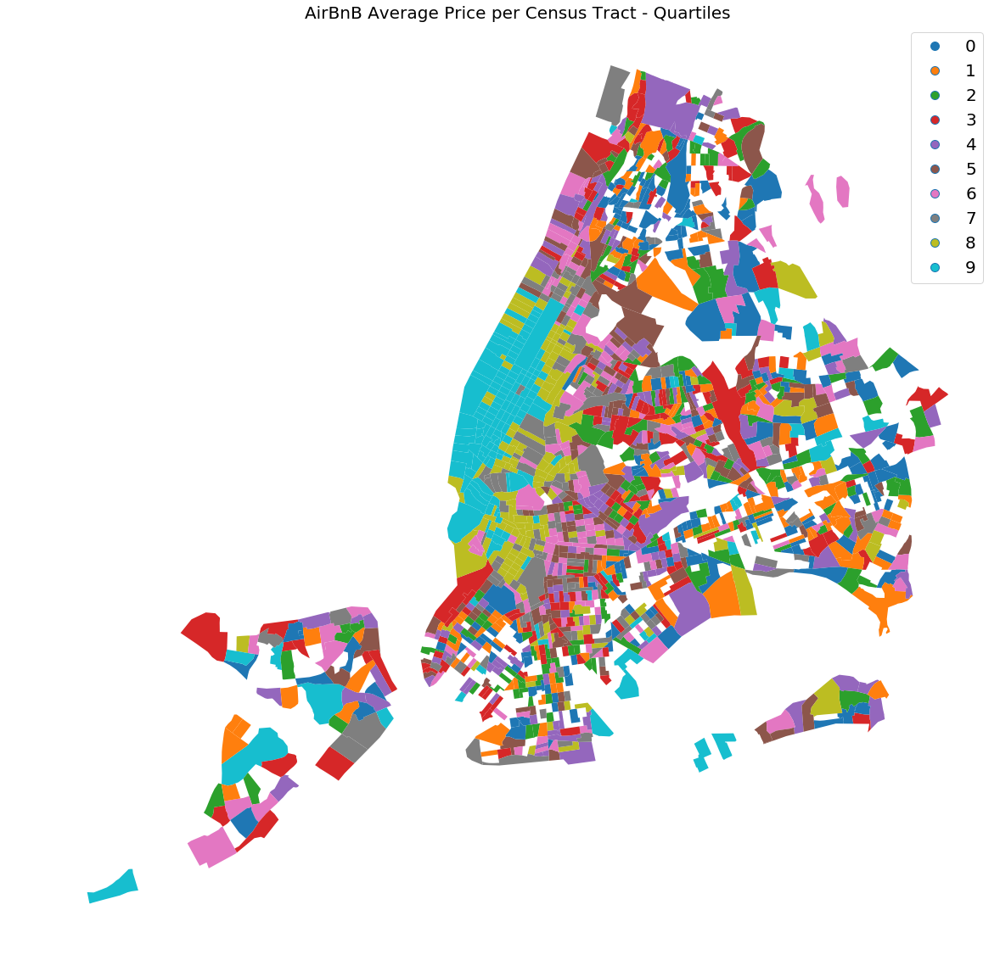

In [101]:
f, ax = plt.subplots(1, figsize=(20, 20))
dataset_clean.assign(avg_listin_QT=quantiles.yb).plot(ax=ax, \
                                                linewidth=0.5, \
                                                column='avg_listin_QT', \
                                                categorical=True, legend=True)

plt.title('AirBnB Average Price per Census Tract - Quartiles', fontsize=tfs)
ax.set_axis_off()
plt.show()

**Interesting, but still not very intuitive or easy to interpret**

** Color maps can be found at following link: **
https://matplotlib.org/examples/color/colormaps_reference.html

In [176]:
#import geopandas as gpd

#tmp = gpd.GeoDataFrame.from_file(clean_shp_file)

#tmpProjection = tmp.to_crs({'proj':'longlat', 'ellps':'WGS84'})

#tmpProjection.to_file('./Data/geomapped.shp')

2018-02-01 18:21:35.074443
2018-02-01 18:21:35.086272
2018-02-01 18:24:47.496540


In [195]:
map.readshapefile(name='tracts', shapefile=clean_shp_file, linewidth=0, zorder=0)


OSError: cannot locate ./Data/nyc_census_tract_features_v3_export_clean.shp.shp

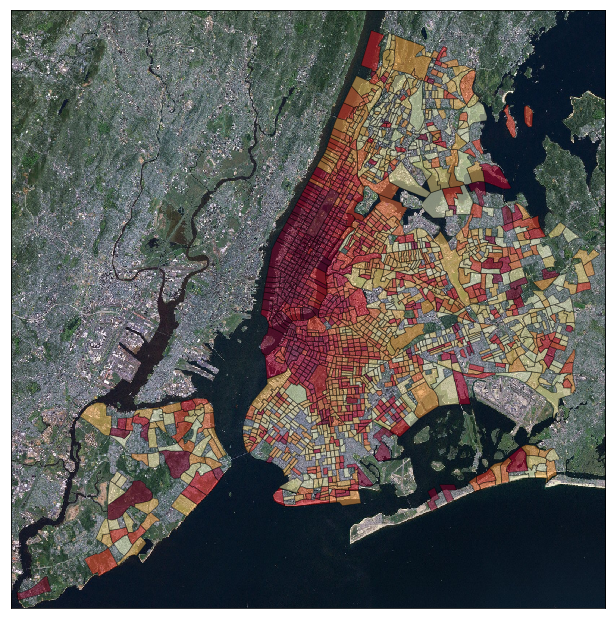

In [196]:
f, ax = plt.subplots(1, figsize=(11, 11))

map = pickle.load(open(pickle_map_name,'rb')) 
#map.drawmapboundary(fill_color='#8aacc8', zorder=1)
#map.fillcontinents(color='#4f9a94',lake_color='5d99c6', zorder=2)
#map.drawcoastlines(linewidth=1.5, zorder=2)
map.arcgisimage(service='ESRI_Imagery_World_2D', xpixels=1000, zorder=2)

map.readshapefile(name='tracts', shapefile=clean_link, linewidth=0, zorder=0)

df_map = pd.DataFrame({
    'poly': [Polygon(xy) for xy in map.tracts],
    'id': [tract['id'] for tract in map.tracts_info],
    'count_list_quantiles': [count_list_quantiles.yb[i] for i in range(0,len(count_list_quantiles.yb))],
    'avg_listin_quantiles': [avg_listin_quantiles.yb[i] for i in range(0,len(avg_listin_quantiles.yb))]})

#map.readshapefile(name='tracts', shapefile='./Data/geomapped', linewidth=0.5)
# use a blue colour ramp - we'll be converting it to a map using cmap()
cmap = plt.get_cmap('YlOrRd')
# draw wards with grey outlines
df_map['patches'] = df_map['poly'].map(lambda x: PolygonPatch(x, edgecolor='black', lw=0.75, zorder=10))
pc = PatchCollection(df_map['patches'], match_original=True, zorder=10)

# impose our colour map onto the patch collection
norm = Normalize()
pc.set_facecolor(cmap(norm(df_map['avg_listin_quantiles'].values)))
pc.set_alpha(0.5)
ax.add_collection(pc)

plt.show()

1685
1685


(array([ 333.,  206.,  143.,  167.,    0.,  185.,  151.,  165.,  169.,  166.]),
 array([ 0. ,  0.8,  1.6,  2.4,  3.2,  4. ,  4.8,  5.6,  6.4,  7.2,  8. ]),
 <a list of 10 Patch objects>)

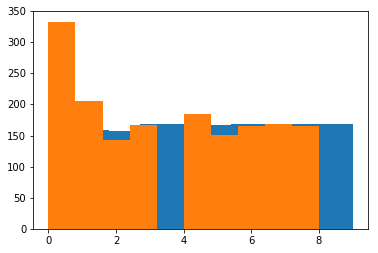

In [183]:
print(len(map.tracts_info))

1685


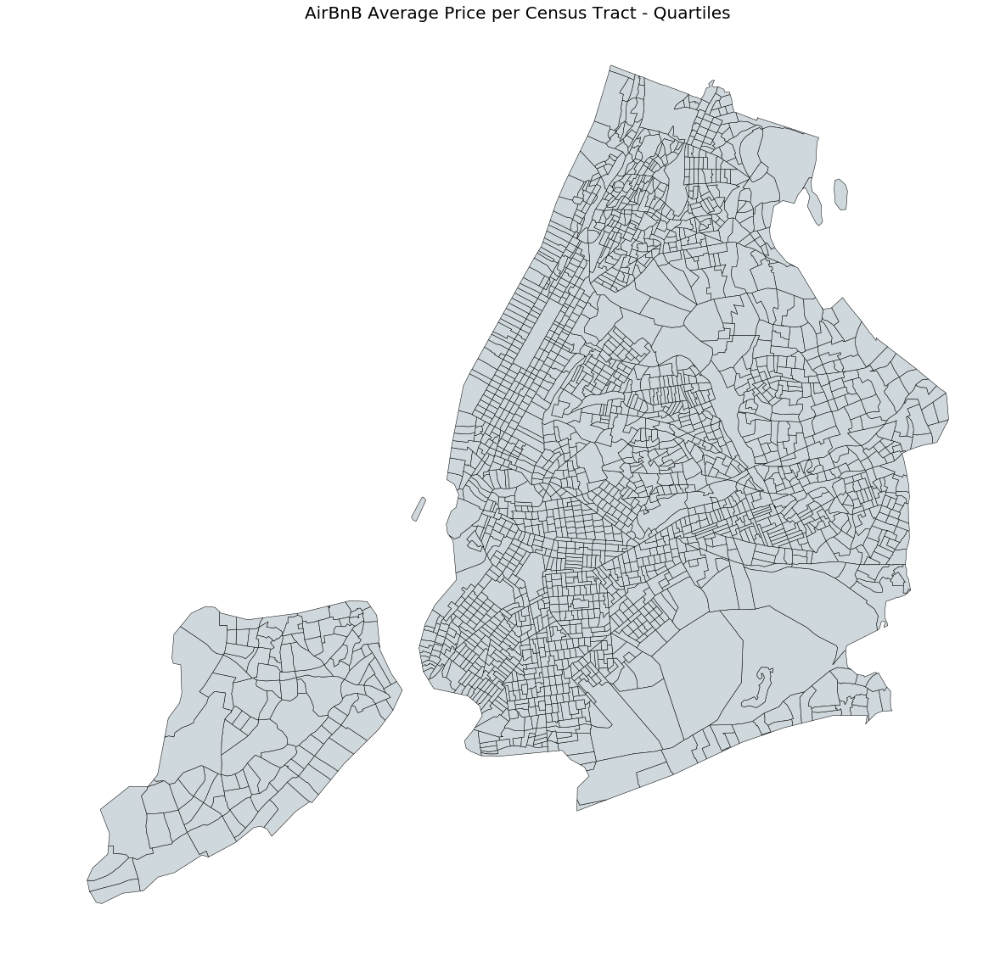

In [150]:

from mpl_toolkits.basemap import Basemap # conda install -c conda-forge basemap 


f, ax = plt.subplots(1, figsize=(20, 20))

dataset.plot(ax=ax, linewidth=0.5, edgecolor='black', color='#cfd8dc')
#dataset_clean.assign(avg_listin_QT=quantiles.yb).plot(ax=ax, \
#                                                linewidth=0.5, \
#                                                edgecolor='black', \
#                                                column='avg_listin_QT', \
#                                                cmap='YlOrRd', \
#                                                categorical=True, \
#                                                legend=True)

plt.title('AirBnB Average Price per Census Tract - Quartiles', fontsize=tfs)
ax.set_axis_off()
plt.show()

## Regressions

**We can 'see' some spatial patterns in the data, so let's get down to the regression business** 

** First step: Normalising our dependent variable**

In [142]:
name_y = ['avg_listin']
y = dataset_clean.loc[:, name_y]
ln_y = np.log(y + 1)
transformed_y = ln_y - mean(ln_y)

# An alternative is to use the BoxCox transformation, uncomment the line below to apply this instead
# transformed_y = analyse_and_transform_wrapper(name_y,y)

**We'll use the Rook Neighbors weighting from before**

**The weights have to be transformed into rows in order to be used...**

**... and then use the pysal spatial lag function with the weights and our dependent variable**

In [143]:
rW.transform = 'r' 
transformed_y_lag = ps.lag_spatial(rW, transformed_y)

**Let's see what these lag values look like!**

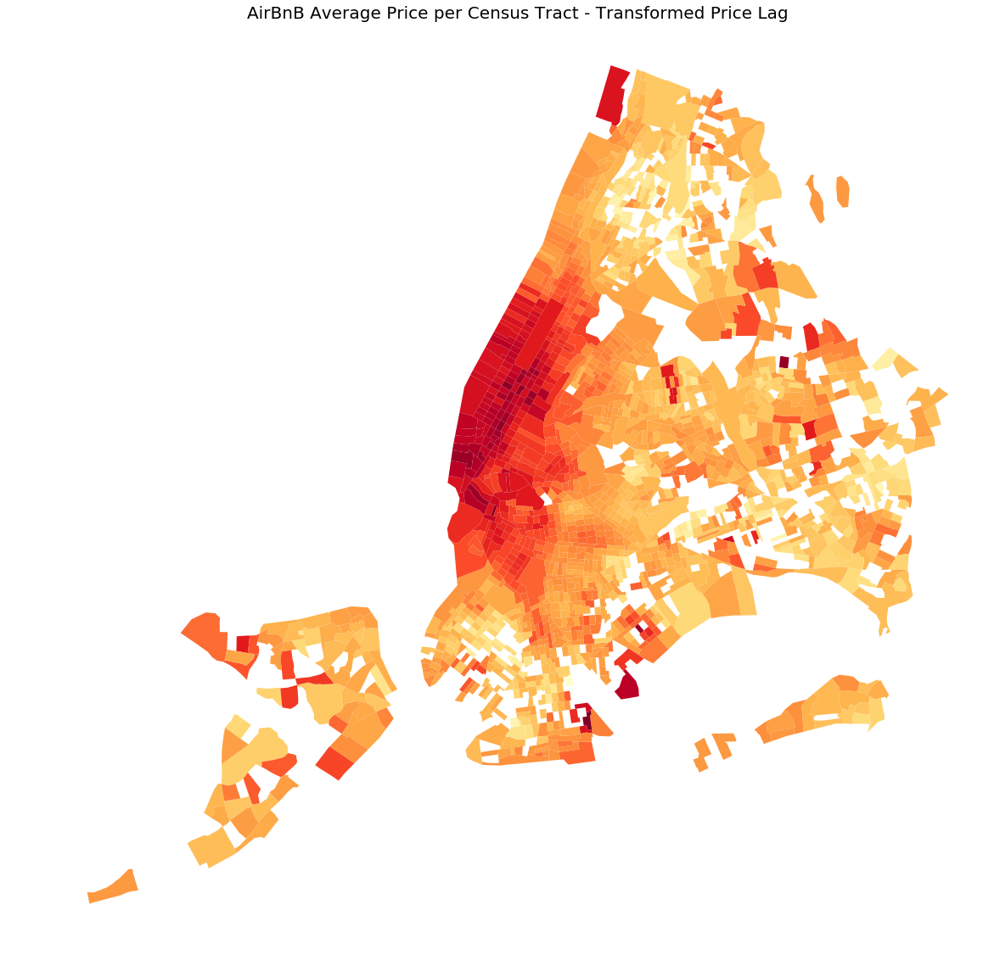

In [144]:
f, ax = plt.subplots(1, figsize=(20, 20))
dataset_clean.assign(transformed_y_lag=transformed_y_lag).plot(ax=ax, \
                                                         linewidth=0.5, \
                                                         column='transformed_y_lag', \
                                                         cmap='YlOrRd')

plt.title('AirBnB Average Price per Census Tract - Transformed Price Lag', fontsize=tfs)
ax.set_axis_off()
plt.show()

**In PySAL, commonly-used analysis methods are very easy to access. **

**For example, we can quickly compute a Moran's I statistic for price**

In [145]:
MI_transformed_y = ps.Moran(transformed_y, rW)
MI_transformed_y.I, MI_transformed_y.p_sim

(0.53395757360068885, 0.001)

**We can plot this and see the relationship between the price and the surrounding lagged price** 

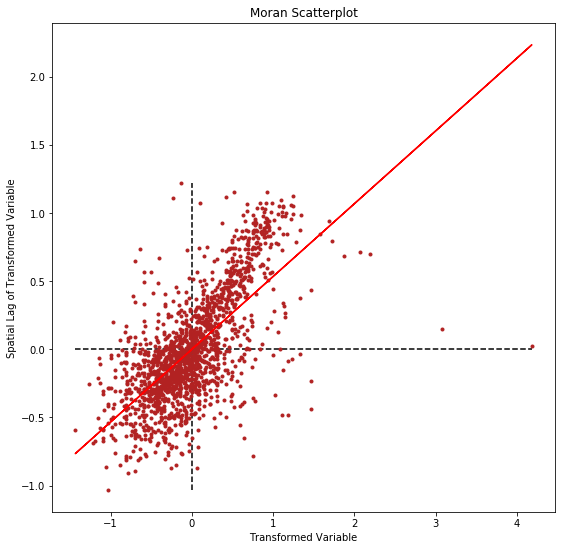

In [146]:
f, ax = plt.subplots(1, figsize=(9, 9))

plt.plot(transformed_y.values, transformed_y_lag, '.', color='firebrick')

plt.vlines(transformed_y.mean(), transformed_y_lag.min(), transformed_y_lag.max(), linestyle='--')
plt.hlines(transformed_y_lag.mean(), transformed_y.min(), transformed_y.max(), linestyle='--')

# red line of best fit using global I as slope
plt.plot(transformed_y.values, MI_transformed_y.I*transformed_y.values, 'r')

plt.title('Moran Scatterplot')
plt.ylabel('Spatial Lag of Transformed Variable')
plt.xlabel('Transformed Variable')
plt.show()


**Lets grab some independent variables...**

0.467093340787
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
[ 410.11832775  256.31246331  324.00656738 ...,  271.81297748  556.15709224
  322.9704422 ]
[ 0.83478334 -0.50792515  0.08303703 ..., -0.37260734  2.10968588
  0.07399177]
X
number of instances:  1684
minimum:  0.0
Q1:  24417.195
median:  44339.765
mean:  51248.5220131
Q3:  67492.36
maximum:  230138.45
standard deviation:  35702.2423843
skewness:  1.1451723785792256


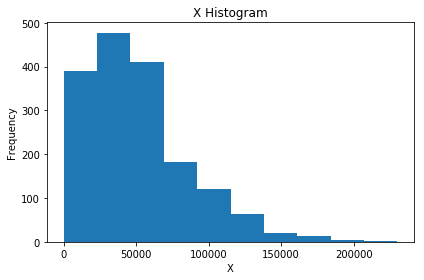

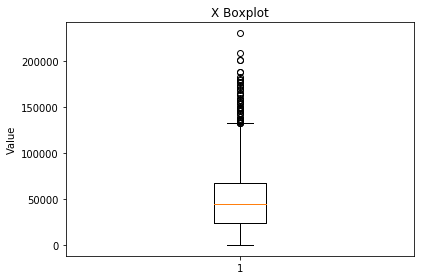

X Standardized
number of instances:  1684
minimum:  -1.43544266664
Q1:  -0.751530582428
median:  -0.193510450652
mean:  -1.79323433906e-16
Q3:  0.454980889214
maximum:  5.01060762686
standard deviation:  1.0
skewness:  1.1451723785792263


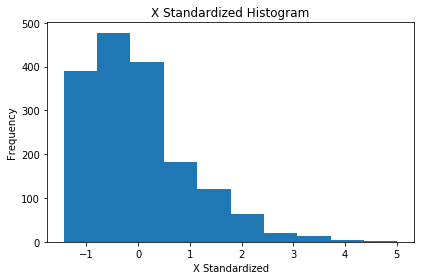

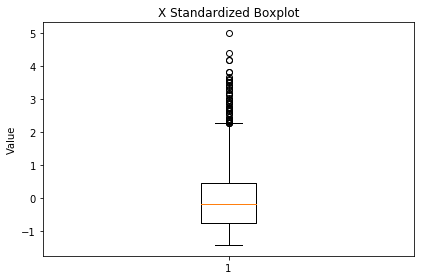

X Transformed
number of instances:  1684
minimum:  0.0
Q1:  237.780014588
median:  314.879453352
mean:  314.494762022
Q3:  383.614465236
maximum:  682.001720825
standard deviation:  114.548963116
skewness:  -0.06922745093223356


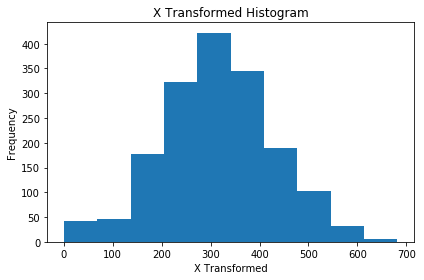

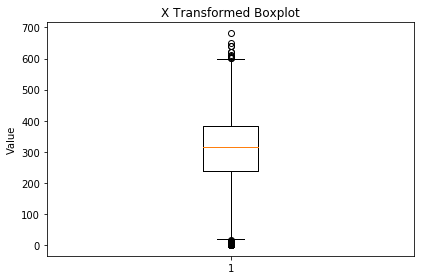

X Transformed Standardized
number of instances:  1684
minimum:  -2.74550509641
Q1:  -0.669711408534
median:  0.00335831350593
mean:  -2.32065620349e-16
Q3:  0.603407497842
maximum:  3.20829581349
standard deviation:  1.0
skewness:  -0.0692274509322327


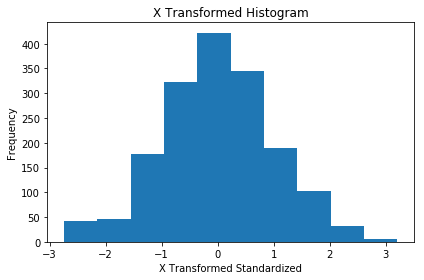

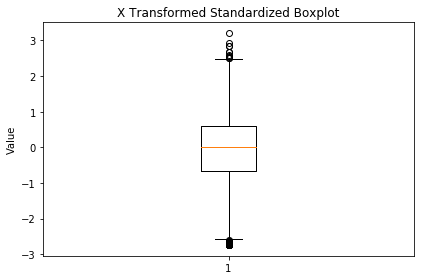

0.435925713051
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
[ 55.14803736  36.14386316  57.44373611 ...,  44.44566187  71.81495989
  42.14721964]
[ 0.12264826 -1.02925885  0.2617983  ..., -0.52605882  1.13288665
 -0.66537516]
X
number of instances:  1684
minimum:  0.0
Q1:  967.75
median:  1448.5
mean:  1682.73574822
Q3:  2069.5
maximum:  12651.0
standard deviation:  1164.2028563
skewness:  2.4502600335933225


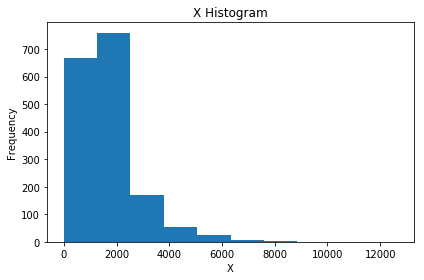

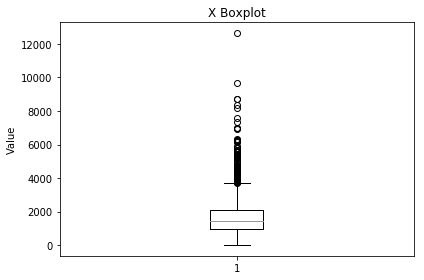

X Standardized
number of instances:  1684
minimum:  -1.44539737135
Q1:  -0.614141894901
median:  -0.201198396783
mean:  2.53162494926e-17
Q3:  0.332213797353
maximum:  9.42126554011
standard deviation:  1.0
skewness:  2.4502600335933225


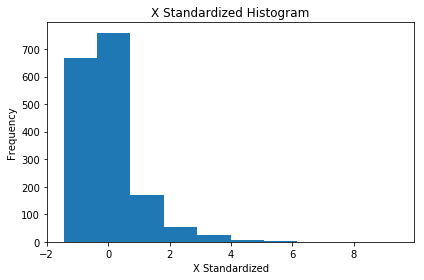

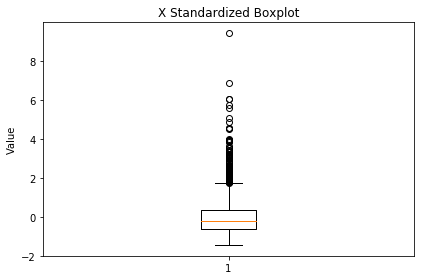

X Transformed
number of instances:  1684
minimum:  0.0
Q1:  43.6632748947
median:  52.4887791805
mean:  53.1245852469
Q3:  61.7016090796
maximum:  138.577868964
standard deviation:  16.4980093823
skewness:  0.2315445429349859


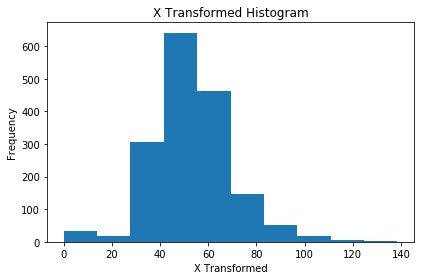

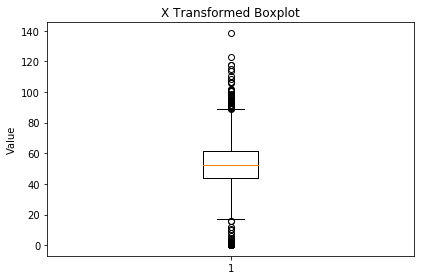

X Transformed Standardized
number of instances:  1684
minimum:  -3.22006031249
Q1:  -0.573481935487
median:  -0.0385383503999
mean:  4.36705303748e-16
Q3:  0.519882346644
maximum:  5.1796117784
standard deviation:  1.0
skewness:  0.23154454293498458


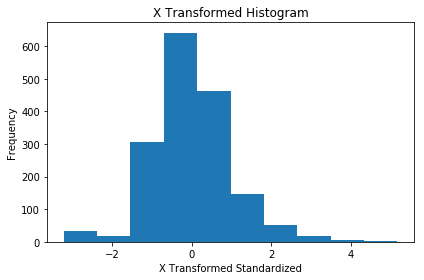

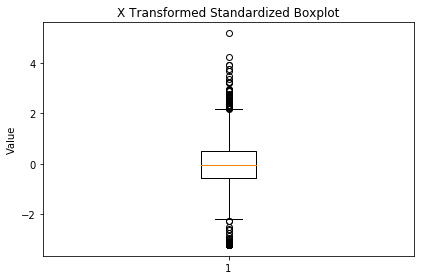

0.0671636243363
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
[ 11.34861995   7.79776004   8.51562538 ...,  14.78093718  12.53884697
   8.77045113]
[ 1.23450573 -0.74837081 -0.34749936 ...,  3.15118548  1.89915409
 -0.20519918]
X
number of instances:  1684
minimum:  0.980934648615
Q1:  615.464973195
median:  1260.82119448
mean:  2183.79714156
Q3:  2358.84444394
maximum:  39764.0551724
standard deviation:  3318.29985416
skewness:  4.959019947541787


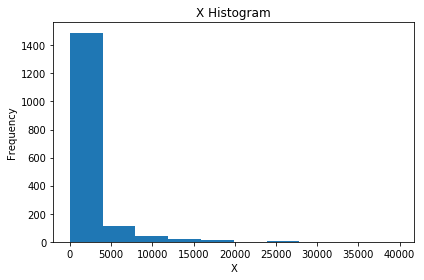

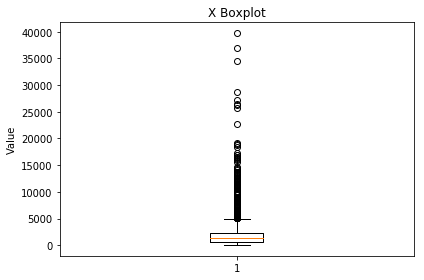

X Standardized
number of instances:  1684
minimum:  -0.657811621267
Q1:  -0.472631238072
median:  -0.278147240346
mean:  4.85228115276e-17
Q3:  0.0527521050166
maximum:  11.3251543509
standard deviation:  1.0
skewness:  4.959019947541786


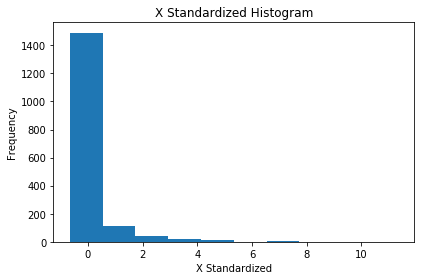

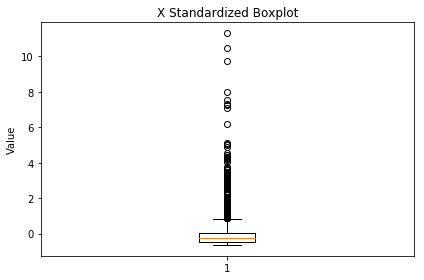

X Transformed
number of instances:  1684
minimum:  0.699503347632
Q1:  8.03265694894
median:  9.16237519934
mean:  9.13791402755
Q3:  10.1952281505
maximum:  15.4348893347
standard deviation:  1.79076197911
skewness:  0.02535407522577679


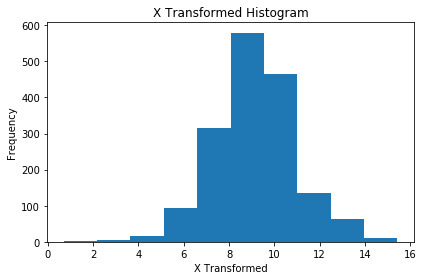

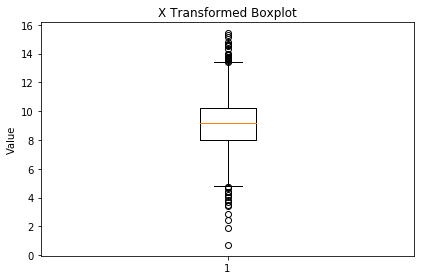

X Transformed Standardized
number of instances:  1684
minimum:  -4.71218999418
Q1:  -0.617199321575
median:  0.0136596443696
mean:  -3.05904681369e-16
Q3:  0.590426944122
maximum:  3.51636642982
standard deviation:  1.0
skewness:  0.025354075225777747


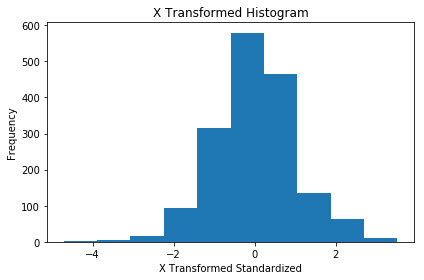

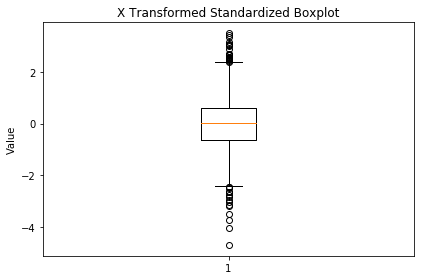

0.266448730414
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
[ 26.39353135  15.68433016  13.59718039 ...,  21.12808049  17.43972479
  20.23782564]
[ 1.39902485 -0.26619084 -0.59072995 ...,  0.58027924  0.00676235
  0.44185003]
X
number of instances:  1684
minimum:  0.0
Q1:  254.90956962
median:  663.341421896
mean:  974.228227335
Q3:  1461.11893481
maximum:  5218.66283577
standard deviation:  931.094713507
skewness:  1.3762919043477075


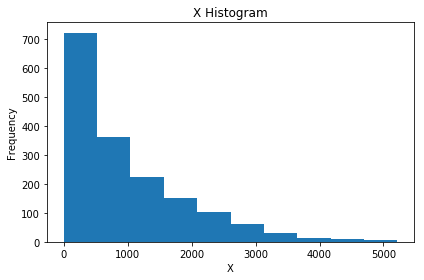

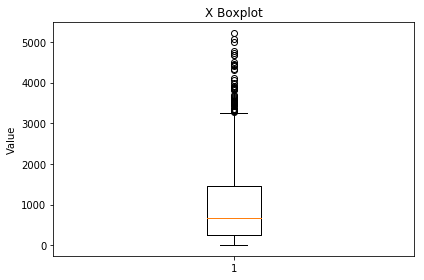

X Standardized
number of instances:  1684
minimum:  -1.04632559202
Q1:  -0.772551543125
median:  -0.333893857337
mean:  -3.58646867812e-17
Q3:  0.52292285673
maximum:  4.5585422695
standard deviation:  1.0
skewness:  1.3762919043477078


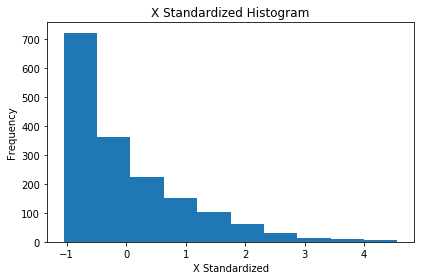

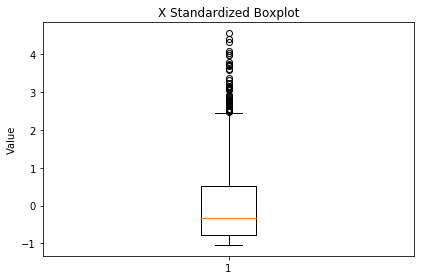

X Transformed
number of instances:  1684
minimum:  0.0
Q1:  12.6913051089
median:  17.4504999731
mean:  17.396235296
Q3:  22.4101963022
maximum:  32.9707194328
standard deviation:  6.43111955164
skewness:  -0.08175231306367085


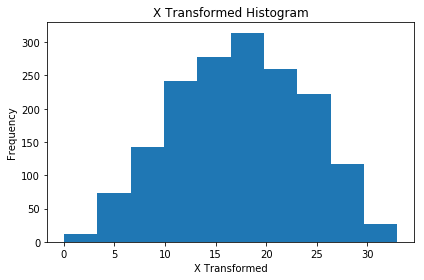

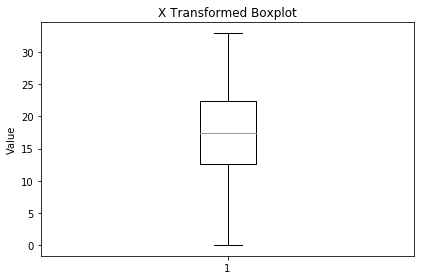

X Transformed Standardized
number of instances:  1684
minimum:  -2.70500884898
Q1:  -0.731588046113
median:  0.00843782745372
mean:  -3.61811398999e-16
Q3:  0.779640460099
maximum:  2.42173761686
standard deviation:  1.0
skewness:  -0.08175231306366955


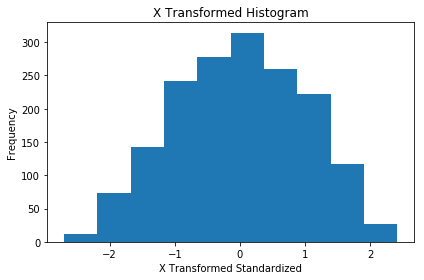

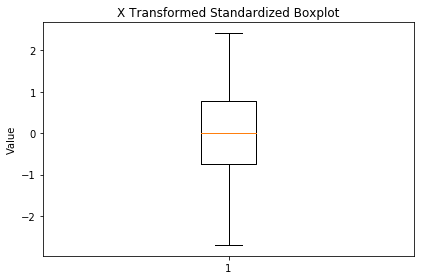

0.350133453016
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
[ 35.14924977  20.00946679  20.83559238 ...,  41.0612543   37.43090932
  30.38251612]
[ 1.4029637  -0.5160962  -0.41137974 ...,  2.15234636  1.69217797
  0.79875112]
X
number of instances:  1684
minimum:  0.0
Q1:  321.307098123
median:  605.904743129
mean:  743.897061386
Q3:  1040.30799541
maximum:  6554.38965926
standard deviation:  576.689462869
skewness:  1.890806456681504


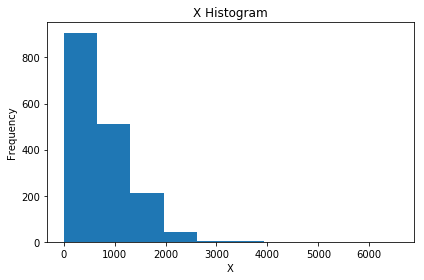

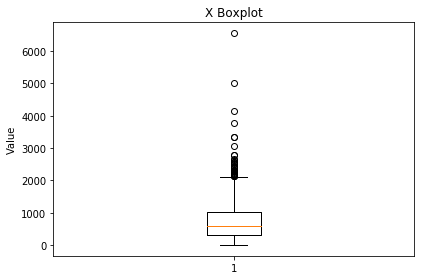

X Standardized
number of instances:  1684
minimum:  -1.28994391138
Q1:  -0.732785997441
median:  -0.239283578324
mean:  -1.62445934244e-16
Q3:  0.513987081619
maximum:  10.0756004262
standard deviation:  1.0
skewness:  1.8908064566815037


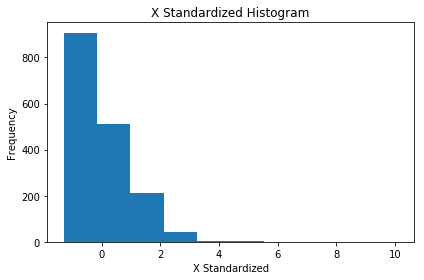

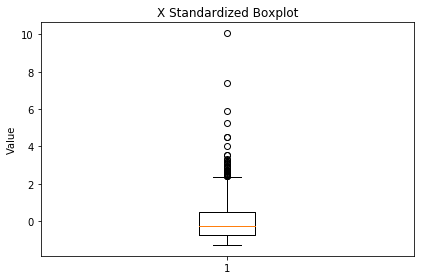

X Transformed
number of instances:  1684
minimum:  0.0
Q1:  18.7211708216
median:  24.0735428918
mean:  24.0810356016
Q3:  29.676772007
maximum:  59.1002083155
standard deviation:  7.88916645809
skewness:  -0.017927031936396998


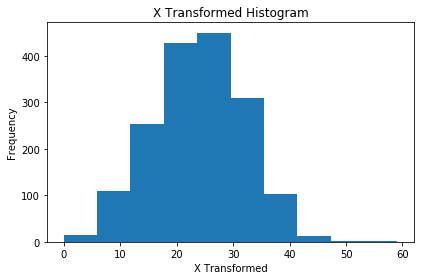

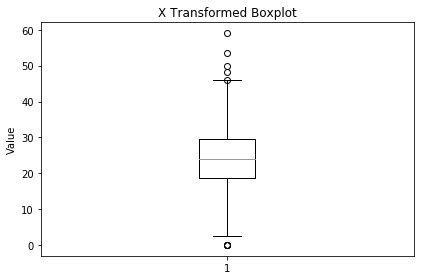

X Transformed Standardized
number of instances:  1684
minimum:  -3.05241824083
Q1:  -0.679395574738
median:  -0.000949746705714
mean:  -3.8818249222e-16
Q3:  0.7092937429
maximum:  4.43889388061
standard deviation:  1.0
skewness:  -0.01792703193639577


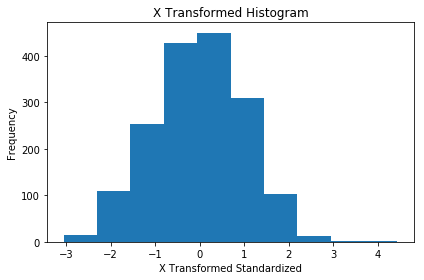

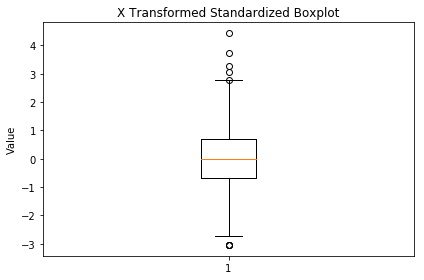

0.207160604038
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
[ 18.96401442  10.7001459   10.64910579 ...,  15.14791524  16.33901255
  17.4801515 ]
[ 1.28321853 -0.5501791  -0.56150271 ...,  0.43658996  0.70084331
  0.95401305]
X
number of instances:  1684
minimum:  0.0
Q1:  234.5183955
median:  538.39051575
mean:  925.522374706
Q3:  1316.13987194
maximum:  6428.70822036
standard deviation:  980.195481333
skewness:  1.7735762821934598


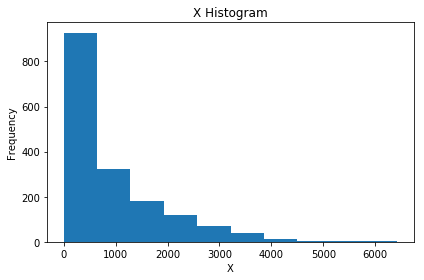

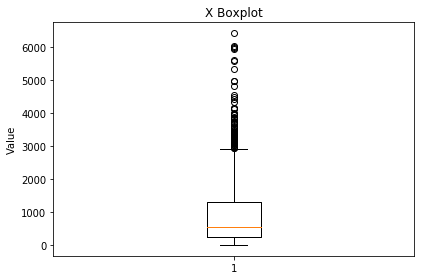

X Standardized
number of instances:  1684
minimum:  -0.944222241719
Q1:  -0.70496548124
median:  -0.394953727424
mean:  6.85648423759e-17
Q3:  0.39850979185
maximum:  5.61437585712
standard deviation:  1.0
skewness:  1.7735762821934595


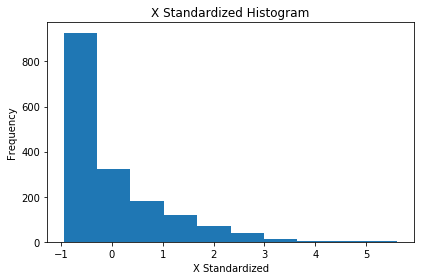

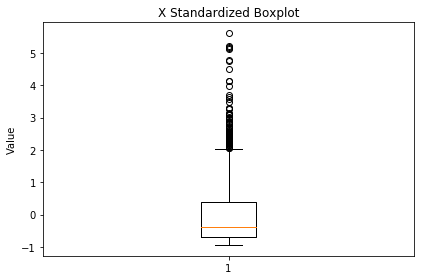

X Transformed
number of instances:  1684
minimum:  0.0
Q1:  10.138040165
median:  12.9407043767
mean:  13.1800267931
Q3:  16.550363838
maximum:  24.8621325538
standard deviation:  4.50740657998
skewness:  -0.04878675214201017


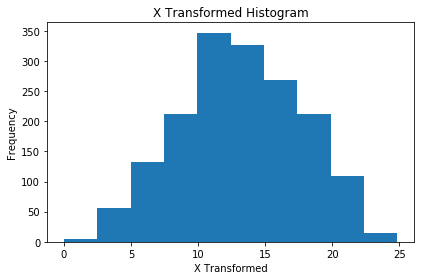

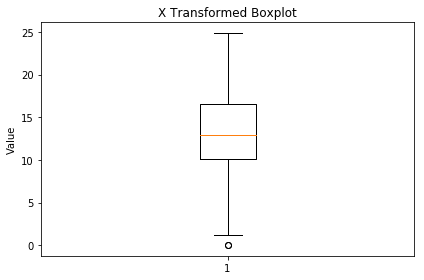

X Transformed Standardized
number of instances:  1684
minimum:  -2.92408207674
Q1:  -0.674886228731
median:  -0.0530953691769
mean:  8.43874983088e-18
Q3:  0.74773308889
maximum:  2.5917577111
standard deviation:  1.0
skewness:  -0.04878675214201017


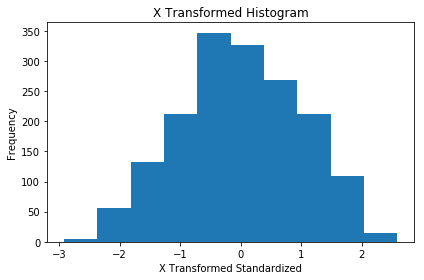

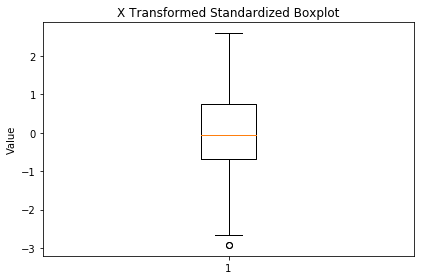

-0.196536948983
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
[ 2.97533333  0.          2.01458772 ...,  0.          0.          0.        ]
[ 1.51044278 -0.96746707  0.71031696 ..., -0.96746707 -0.96746707
 -0.96746707]
X
number of instances:  1684
minimum:  0.0
Q1:  0.0
median:  1.25618350896
mean:  16.0728164783
Q3:  20.6509286828
maximum:  216.892682021
standard deviation:  26.501183749
skewness:  2.6390234154632304


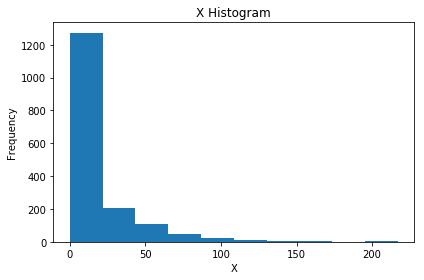

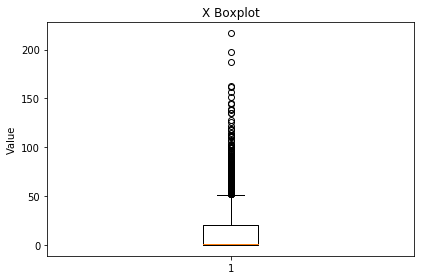

X Standardized
number of instances:  1684
minimum:  -0.606494284576
Q1:  -0.606494284576
median:  -0.559093250688
mean:  -4.11389054255e-17
Q3:  0.172751234355
maximum:  7.57776963642
standard deviation:  1.0
skewness:  2.6390234154632295


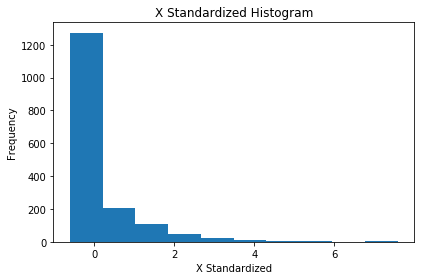

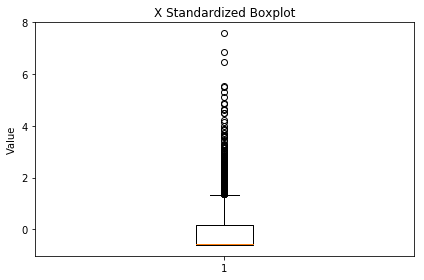

X Transformed
number of instances:  1684
minimum:  0.0
Q1:  0.0
median:  0.751764021096
mean:  1.16167947593
Q3:  2.30784239224
maximum:  3.32204478685
standard deviation:  1.20074316973
skewness:  0.19586814171645578


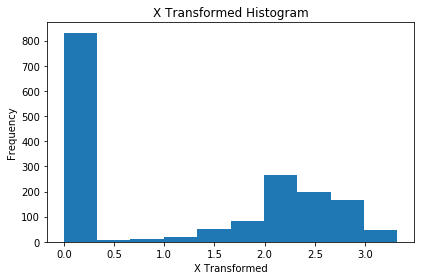

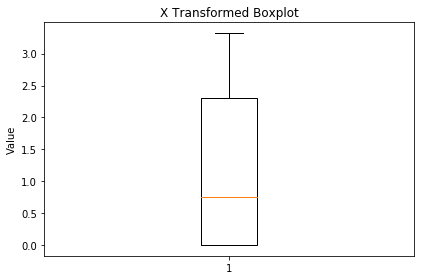

X Transformed Standardized
number of instances:  1684
minimum:  -0.96746706974
Q1:  -0.96746706974
median:  -0.341384789994
mean:  2.10968745772e-18
Q3:  0.954544606372
maximum:  1.7991901727
standard deviation:  1.0
skewness:  0.19586814171645583


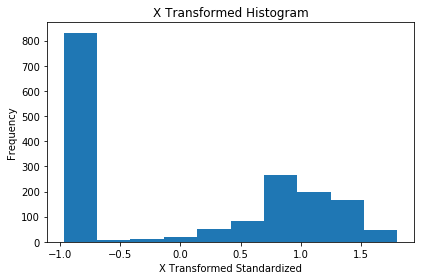

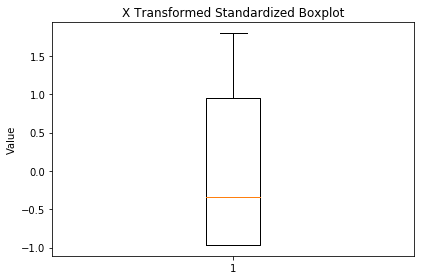

In [147]:
name_x=['checkins_t','population','avg_qscore','incidents_']
#name_x=['population','total_hous','larcenie_1','robberie_1','burglari_1','assaults_1','murders__1',]
x = dataset_clean.loc[:, name_x]
transformed_x = analyse_and_transform_wrapper(name_x,x)

**To run the model, we can use the spreg module in PySAL, which implements a standard OLS routine, but is particularly well suited for regressions on spatial data. Also, although for the initial model we do not need it, let us build a spatial weights matrix that connects every observation to its 8 nearest neighbors. This will allow us to get extra diagnostics from the baseline model.**

In [148]:
model_ols = ps.spreg.OLS(y=transformed_y.values, \
                         x=transformed_x.values, \
                         w=rW, \
                         name_y='transformed_average_price', \
                         name_x=name_x, \
                         spat_diag=True)
print(model_ols.summary)

REGRESSION
----------
SUMMARY OF OUTPUT: ORDINARY LEAST SQUARES
-----------------------------------------
Data set            :     unknown
Weights matrix      :     unknown
Dependent Variable  :transformed_average_price                Number of Observations:        1684
Mean dependent var  :      0.0000                Number of Variables   :           8
S.D. dependent var  :      0.5153                Degrees of Freedom    :        1676
R-squared           :      0.2584
Adjusted R-squared  :      0.2553
Sum squared residual:     331.484                F-statistic           :     83.4109
Sigma-square        :       0.198                Prob(F-statistic)     :  3.482e-104
S.E. of regression  :       0.445                Log likelihood        :   -1020.949
Sigma-square ML     :       0.197                Akaike info criterion :    2057.898
S.E of regression ML:      0.4437                Schwarz criterion     :    2101.329

----------------------------------------------------------------

**If we include the lagged prices of the neighbors in the model, we violate some of the assumptions on which OLS relies. **

**We can use GM_lag to account for this and include the spatially lagged varible**

In [149]:
model_lag = ps.spreg.GM_Lag(y=transformed_y.values, \
                            x=transformed_x.values, \
                            w=rW, \
                            name_y='transformed_average_price', \
                            name_x=name_x)
print(model_lag.summary)

REGRESSION
----------
SUMMARY OF OUTPUT: SPATIAL TWO STAGE LEAST SQUARES
--------------------------------------------------
Data set            :     unknown
Weights matrix      :     unknown
Dependent Variable  :transformed_average_price                Number of Observations:        1684
Mean dependent var  :      0.0000                Number of Variables   :           9
S.D. dependent var  :      0.5153                Degrees of Freedom    :        1675
Pseudo R-squared    :      0.4571
Spatial Pseudo R-squared: omitted due to rho outside the boundary (-1, 1).
------------------------------------------------------------------------------------
            Variable     Coefficient       Std.Error     z-Statistic     Probability
------------------------------------------------------------------------------------
            CONSTANT      -0.0026360       0.0094466      -0.2790392       0.7802148
          population      -0.0098305       0.0194985      -0.5041674       0.6141438
      

**There are several over spatial regression methods built into PySAL**

**Spatial Error is when the error values in the models are spatially lagged**

In [132]:
model_error = ps.spreg.GM_Error(y=transformed_y.values, \
                                x=transformed_x.values, \
                                w=rW, \
                                name_y='transformed_average_price', \
                                name_x=name_x)
print(model_error.summary)

REGRESSION
----------
SUMMARY OF OUTPUT: SPATIALLY WEIGHTED LEAST SQUARES
---------------------------------------------------
Data set            :     unknown
Weights matrix      :     unknown
Dependent Variable  :transformed_average_price                Number of Observations:        1684
Mean dependent var  :     -0.0000                Number of Variables   :           8
S.D. dependent var  :      1.0003                Degrees of Freedom    :        1676
Pseudo R-squared    :      0.2313

------------------------------------------------------------------------------------
            Variable     Coefficient       Std.Error     z-Statistic     Probability
------------------------------------------------------------------------------------
            CONSTANT       0.0011881       0.0346021       0.0343358       0.9726094
          population       0.0007893       0.0330131       0.0239074       0.9809265
          larcenie_1       0.4496615       0.0470654       9.5539642       0.0

**Spatial Combo is when both the dependent variable and the error values in the models are spatially lagged**

In [141]:
model_combo = ps.spreg.GM_Combo(y=transformed_y.values, \
                                x=transformed_x.values, \
                                w=rW, \
                                name_y='transformed_average_price', \
                                name_x=name_x)
print(model_combo.summary)

REGRESSION
----------
SUMMARY OF OUTPUT: SPATIALLY WEIGHTED TWO STAGE LEAST SQUARES
-------------------------------------------------------------
Data set            :     unknown
Weights matrix      :     unknown
Dependent Variable  :transformed_average_price                Number of Observations:        1684
Mean dependent var  :     -0.0000                Number of Variables   :           9
S.D. dependent var  :      1.0003                Degrees of Freedom    :        1675
Pseudo R-squared    :      0.4607
Spatial Pseudo R-squared: omitted due to rho outside the boundary (-1, 1).
------------------------------------------------------------------------------------
            Variable     Coefficient       Std.Error     z-Statistic     Probability
------------------------------------------------------------------------------------
            CONSTANT      -0.0016769       0.0069891      -0.2399322       0.8103828
          population      -0.0223124       0.0253029      -0.8818136 

**Interested in trying out some other regressions? Here's a list of the variables in the dataset**
*Refer to the powerpoint for a complete list of the full names*.

In [114]:
# Interested to see the data? Uncomment and run the command below
dataset.columns.tolist()


['geom_id',
 'id',
 'county',
 'tract',
 'geom_gps',
 'locations_',
 'incidents_',
 'incident_1',
 'larcenies_',
 'robberies_',
 'burglaries',
 'assaults_2',
 'vehicles_2',
 'murders_20',
 'rapes_2011',
 'incident_2',
 'incident_3',
 'larcenie_1',
 'robberie_1',
 'burglari_1',
 'assaults_1',
 'vehicles_1',
 'murders__1',
 'rapes_20_1',
 'incident_4',
 'incident_5',
 'larcenie_2',
 'robberie_2',
 'burglari_2',
 'assaults_3',
 'vehicles_3',
 'murders__2',
 'rapes_20_2',
 'area',
 'logrecno',
 'population',
 'total_popu',
 'male_popul',
 'male_fract',
 'male_15_34',
 'male_15__1',
 'avg_age',
 'male_avg_a',
 'female_avg',
 'i_mb17',
 'i_m18_34',
 'i_m35_64',
 'i_mo65',
 'i_fb17',
 'i_f18_34',
 'i_f35_64',
 'i_fo65',
 'age_index',
 'black_popu',
 'black_frac',
 'asian_popu',
 'asian_frac',
 'hispanic_p',
 'hispanic_f',
 'i_white',
 'i_black',
 'i_asian',
 'i_other',
 'i_hispanic',
 'racial_eth',
 'total_hous',
 'housing_de',
 'vacant_hou',
 'vacant_fra',
 'rented_hou',
 'rented_fra',
 'avg

## Adding the listing attributes and running the analysis on point level

**We need to import the data from the other shape file**

In [4]:
airbnb_shp_link = "./Data/export.shp"
airbnb_tx = ps.pdio.read_files(airbnb_shp_link)
#print(type(airbnb_tx))
airbnb_tx.head()

,listing_id,gps_coord,latitude,longitude,room_type,accomodate,bathrooms,bedrooms,beds,bed_type,...,mta_we_wee,mta_we_w_1,mta_week_w,mta_week_1,mta_we_mor,mta_week_m,max_qscore,min_qscore,avg_qscore,geometry
0,10267,SRID=4326;POINT(-73.9631246 40.67543027),40.675430,-73.963125,0,1,1.0,1.0,1.0,Real Bed,...,NaN,NaN,NaN,NaN,,,37.892654,18.491983,26.732454,"(994478.6093965571, 185356.02239743754)"
1,25095,SRID=4326;POINT(-73.95799829 40.74576918),40.745769,-73.957998,1,4,1.0,0.0,2.0,Real Bed,...,2055.754902,1897.343137,2.814611e+04,3.403660e+04,t,f,32.999825,-4.000000,18.710652,"(995888.2729739572, 210983.2532779986)"
2,36882,SRID=4326;POINT(-73.998693 40.73792111),40.737921,-73.998693,1,2,1.0,0.0,1.0,Real Bed,...,3624.872549,8209.343137,1.168052e+07,1.192429e+07,f,f,41.670647,15.671375,27.412698,"(984612.1999021632, 208121.1643725)"
3,0,SRID=4326;POINT(-73.78867963 40.85205378),40.852054,-73.788680,0,2,1.0,1.0,1.0,Real Bed,...,NaN,NaN,NaN,NaN,,,NaN,NaN,NaN,"(1042711.3870158461, 249774.17458121327)"
4,3,SRID=4326;POINT(-73.78660939 40.84977457),40.849775,-73.786609,1,3,1.0,1.0,1.0,Real Bed,...,NaN,NaN,NaN,NaN,,,NaN,NaN,NaN,"(1043286.1368261221, 248945.16253132556)"


***Let's check the name and unit of the projection***

In [3]:
driver = ogr.GetDriverByName('ESRI Shapefile')
shape = driver.Open('./Data/export.shp')
layer= shape.GetLayer()
spatial_ref = layer.GetSpatialRef()
print(spatial_ref)
# using local NY Long Island projection in US feet

PROJCS["NAD83_New_York_Long_Island_ftUS",
    GEOGCS["GCS_North_American_1983",
        DATUM["North_American_Datum_1983",
            SPHEROID["GRS_1980",6378137,298.257222101]],
        PRIMEM["Greenwich",0],
        UNIT["Degree",0.017453292519943295]],
    PROJECTION["Lambert_Conformal_Conic_2SP"],
    PARAMETER["standard_parallel_1",41.03333333333333],
    PARAMETER["standard_parallel_2",40.66666666666666],
    PARAMETER["latitude_of_origin",40.16666666666666],
    PARAMETER["central_meridian",-74],
    PARAMETER["false_easting",984250.0000000002],
    PARAMETER["false_northing",0],
    UNIT["Foot_US",0.30480060960121924]]


In [4]:
data = airbnb_tx.fillna(0)
data.info() 

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 31454 entries, 0 to 31453
Columns: 206 entries, listing_id to geometry
dtypes: float64(147), int64(4), object(55)
memory usage: 49.4+ MB


In [5]:
# Interested to see the data? 
data.columns.tolist()

['listing_id',
 'gps_coord',
 'latitude',
 'longitude',
 'room_type',
 'accomodate',
 'bathrooms',
 'bedrooms',
 'beds',
 'bed_type',
 'square_fee',
 'number_of_',
 'review_sco',
 'review_s_1',
 'review_s_2',
 'review_s_3',
 'review_s_4',
 'reviews_pe',
 'price',
 'weekly_pri',
 'monthly_pr',
 'geom_id',
 'id',
 'county',
 'tract',
 'geom_gps',
 'geom_ftus',
 'locations_',
 'incidents_',
 'incident_1',
 'larcenies_',
 'robberies_',
 'burglaries',
 'assaults_2',
 'vehicles_2',
 'murders_20',
 'rapes_2011',
 'incident_2',
 'incident_3',
 'larcenie_1',
 'robberie_1',
 'burglari_1',
 'assaults_1',
 'vehicles_1',
 'murders__1',
 'rapes_20_1',
 'incident_4',
 'incident_5',
 'larcenie_2',
 'robberie_2',
 'burglari_2',
 'assaults_3',
 'vehicles_3',
 'murders__2',
 'rapes_20_2',
 'area',
 'logrecno',
 'population',
 'total_popu',
 'male_popul',
 'male_fract',
 'male_15_34',
 'male_15__1',
 'avg_age',
 'male_avg_a',
 'female_avg',
 'i_mb17',
 'i_m18_34',
 'i_m35_64',
 'i_mo65',
 'i_fb17',
 'i_f1

**Prepare the dependent variable**

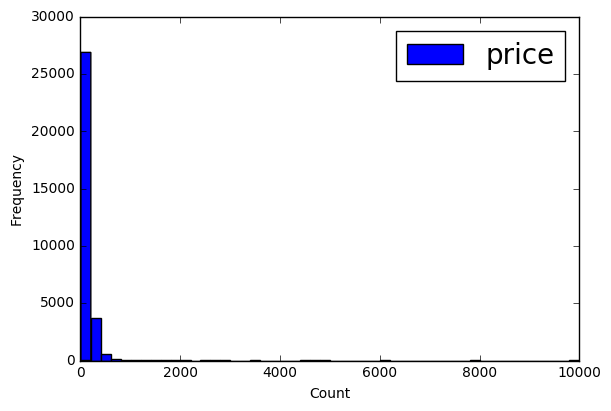

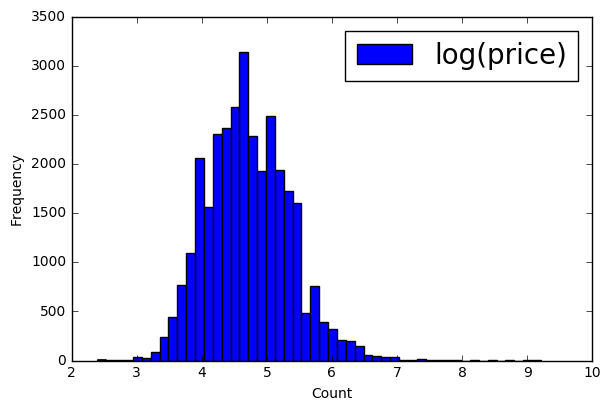

In [6]:
ybins = 50
plt.hist(data['price'].values, bins=ybins, label='price')
plt.rc('legend', fontsize=20) 
plt.tight_layout()
plt.xlabel('Count')
plt.ylabel('Frequency')
plt.legend(loc='upper right')
plt.show()
plt.clf()

data['price_log'] = data['price'].apply(helpers.smooth_log)
#data['price_log'] = np.log(data['price'] + 1.0)

ybins = 50
plt.hist(data['price_log'].values, bins=ybins, label='log(price)')
plt.rc('legend', fontsize=20) 
plt.tight_layout()
plt.xlabel('Count')
plt.ylabel('Frequency')
plt.legend(loc='upper right')
plt.show()
plt.clf()

**Prepare the independent variables**

In [7]:
set(data.bed_type)

{'Airbed', 'Couch', 'Futon', 'Pull-out Sofa', 'Real Bed'}

In [8]:
# lets simplify things
def has_realbed(a):
    if (a=='Real Bed'):
        return 1
    else:
        return 0
data['bedroom_type'] = data['bed_type'].apply(has_realbed)


0.339256120889
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
[  4.16384513   4.03567038   3.17374791 ...,   7.29071812   0.          11.15989213]
[-0.41517493 -0.49638915 -1.04252142 ...,  1.5660778  -3.05347508
  4.01766812]
X
number of instances:  31454
minimum:  0.0
Q1:  9.7625
median:  16.02
mean:  18.443950213
Q3:  25.64
maximum:  100.0
standard deviation:  10.9578007653
skewness:  0.785790104452521


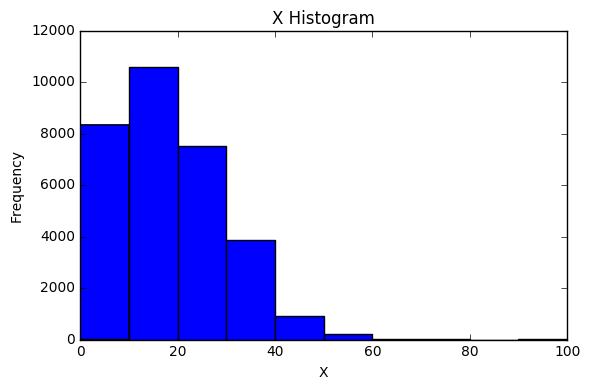

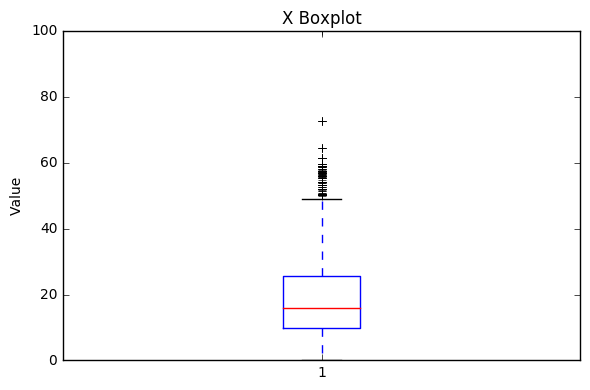

X Standardized
number of instances:  31454
minimum:  -1.68317991977
Q1:  -0.792262097017
median:  -0.221207728168
mean:  -1.59032900736e-16
Q3:  0.656705660298
maximum:  7.44273887925
standard deviation:  1.0
skewness:  0.7857901044525211


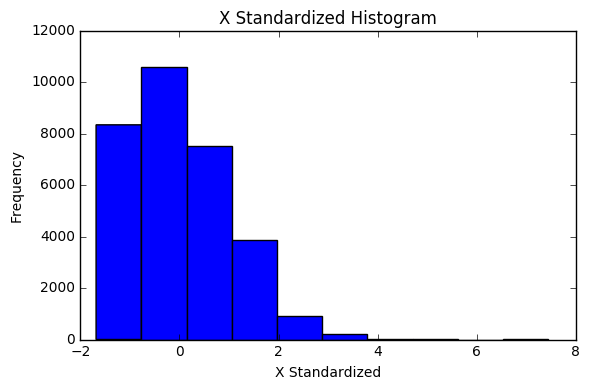

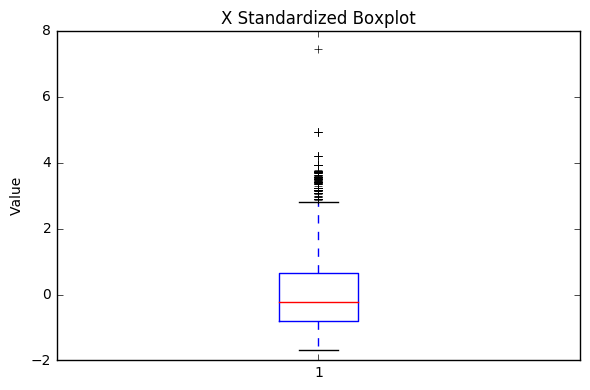

X Transformed
number of instances:  31454
minimum:  0.0
Q1:  3.65254215079
median:  4.76288034471
mean:  4.8190867528
Q3:  6.02859509114
maximum:  11.1598921296
standard deviation:  1.57823025334
skewness:  -0.03351536520082319


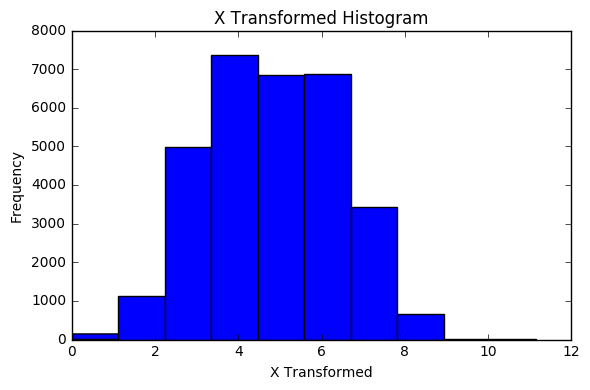

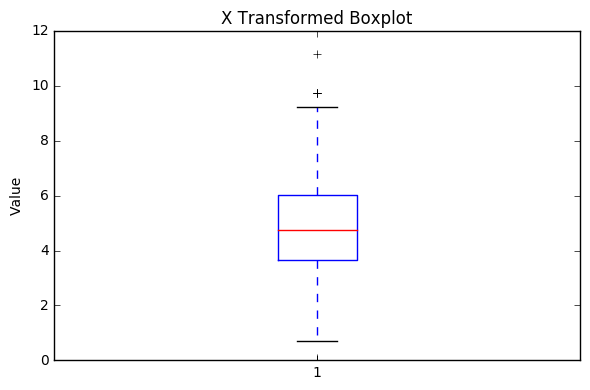

X Transformed Standardized
number of instances:  31454
minimum:  -3.05347508236
Q1:  -0.739147281924
median:  -0.0356135665116
mean:  4.33726092916e-16
Q3:  0.766370012093
maximum:  4.01766812124
standard deviation:  1.0
skewness:  -0.03351536520082441


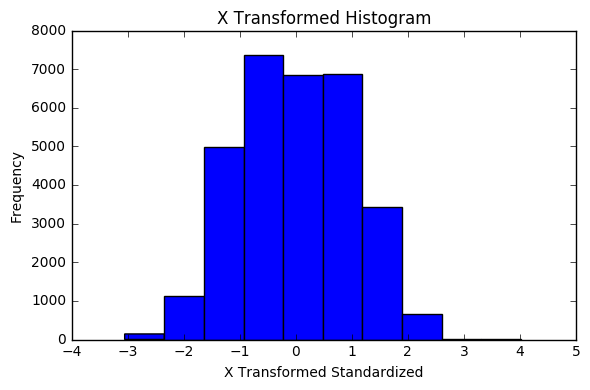

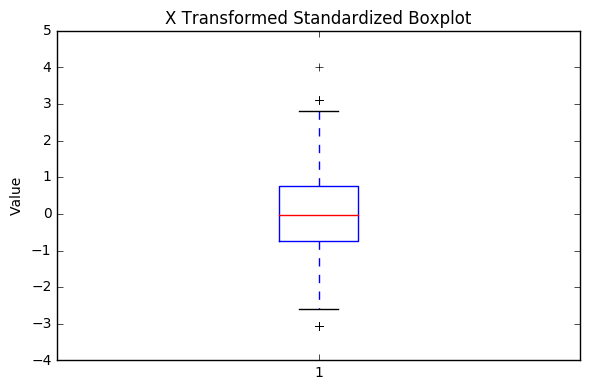

-0.177076866393
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
[ 2.79133003  1.77480625  0.94418184 ...,  2.36304264  0.          3.00554497]
[ 1.14422814 -0.13504422 -1.1803664  ...,  0.60523807 -2.36859807
  1.41381283]
X
number of instances:  31454
minimum:  0.0
Q1:  2.92
median:  7.44
mean:  22.5675303618
Q3:  36.63
maximum:  96.55
standard deviation:  27.6139921891
skewness:  1.219727669709544


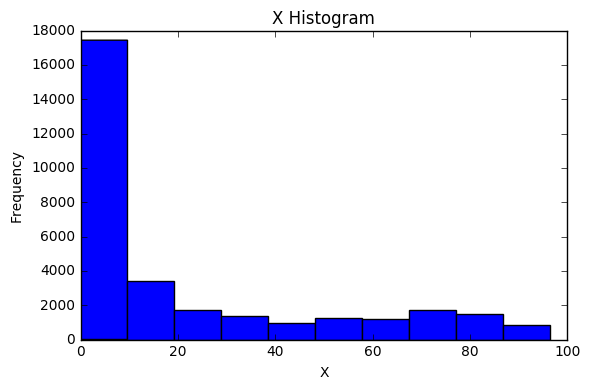

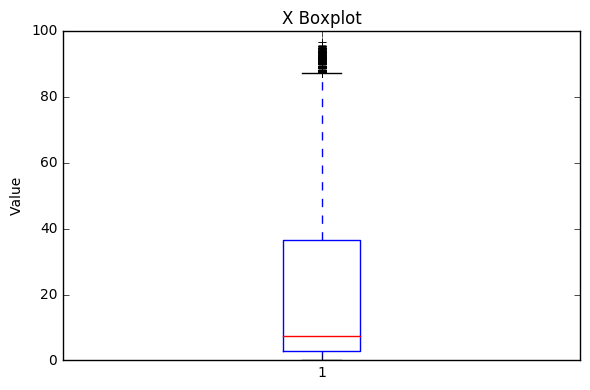

X Standardized
number of instances:  31454
minimum:  -0.817249827814
Q1:  -0.711506334443
median:  -0.547821200868
mean:  7.22876821527e-17
Q3:  0.509251597592
maximum:  2.67916602321
standard deviation:  1.0
skewness:  1.219727669709544


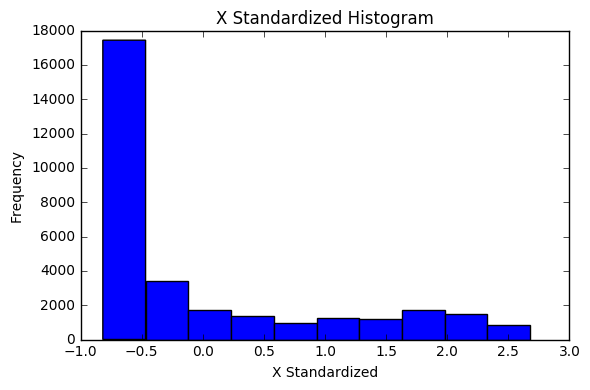

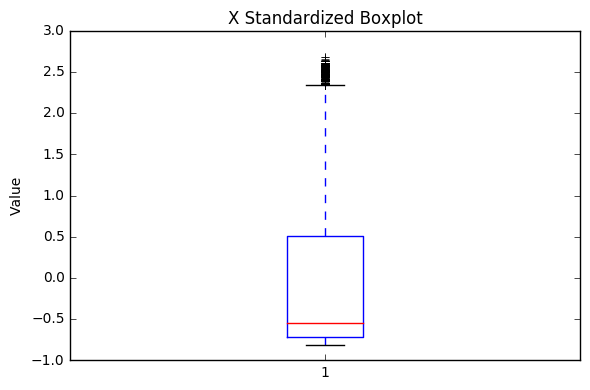

X Transformed
number of instances:  31454
minimum:  0.0
Q1:  1.21341569163
median:  1.77643277461
mean:  1.88211386561
Q3:  2.67664225878
maximum:  3.1377370907
standard deviation:  0.794610909655
skewness:  0.09632940778090643


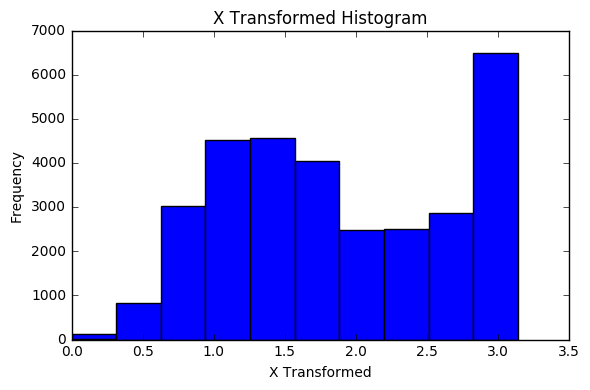

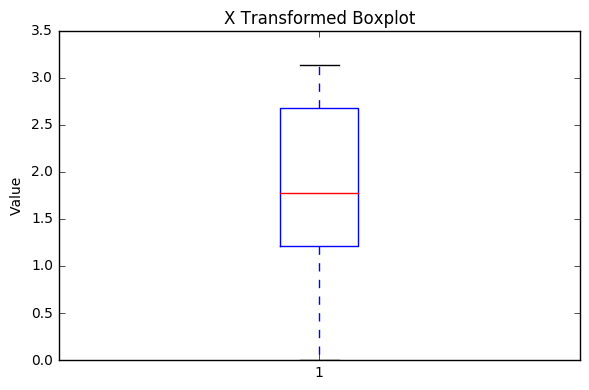

X Transformed Standardized
number of instances:  31454
minimum:  -2.36859806824
Q1:  -0.84154164744
median:  -0.132997281709
mean:  3.18065801472e-16
Q3:  0.999896154852
maximum:  1.58017365459
standard deviation:  1.0
skewness:  0.09632940778090562


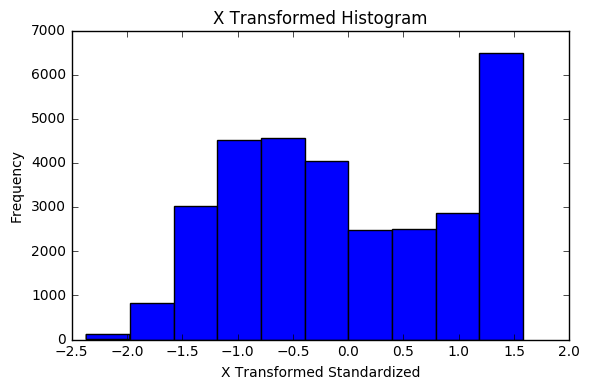

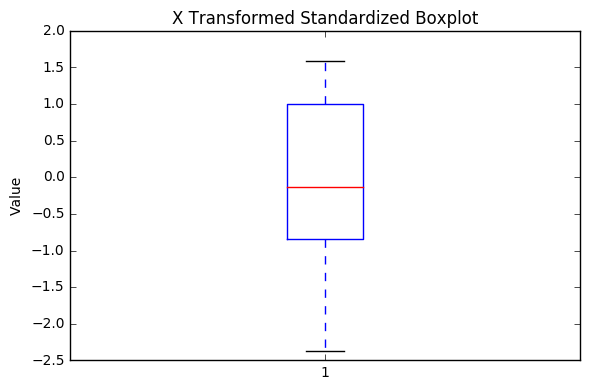

-0.0663588008124
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
[ 2.23902081  2.20118652  1.79089654 ...,  3.47168544  0.          2.89832255]
[-0.63038726 -0.6891548  -1.32645307 ...,  1.28429525 -4.10823021
  0.39369785]
X
number of instances:  31454
minimum:  0.0
Q1:  9.04
median:  16.74
mean:  24.3806224963
Q3:  33.09
maximum:  100.0
standard deviation:  20.7505196346
skewness:  1.2930032402372271


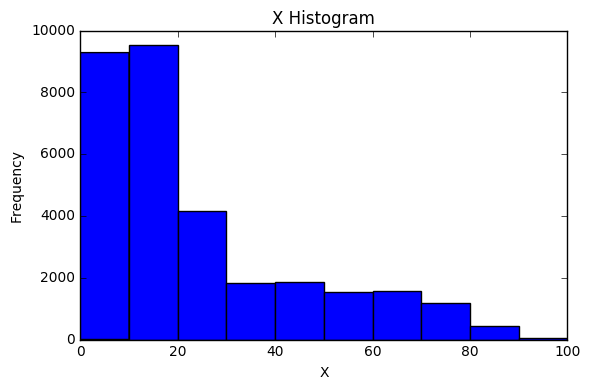

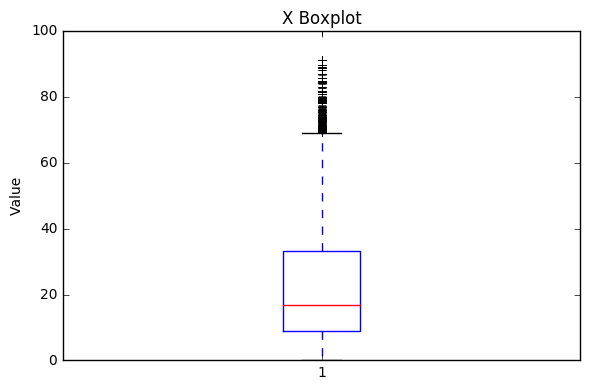

X Standardized
number of instances:  31454
minimum:  -1.17494033526
Q1:  -0.739288594527
median:  -0.368213549872
mean:  -2.38549351104e-16
Q3:  0.419718525465
maximum:  3.64421608882
standard deviation:  1.0
skewness:  1.2930032402372276


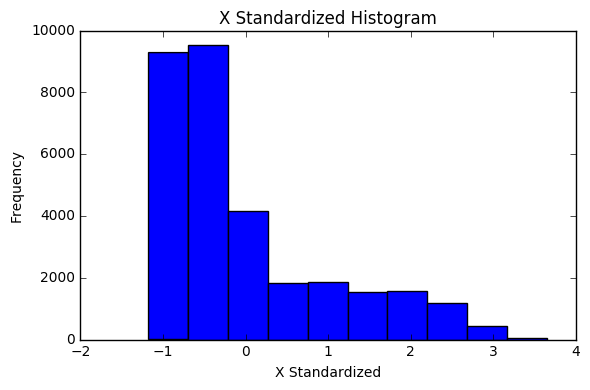

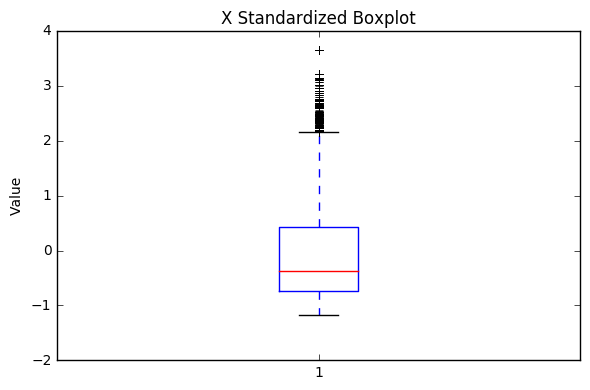

X Transformed
number of instances:  31454
minimum:  0.0
Q1:  2.13872484045
median:  2.61807015231
mean:  2.64486150539
Q3:  3.1462442513
maximum:  3.9753626494
standard deviation:  0.64379583621
skewness:  0.006319670918953505


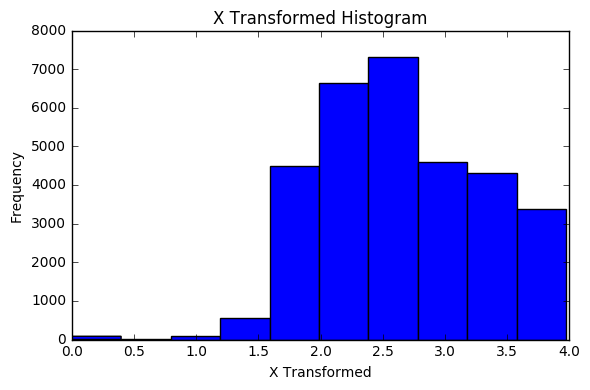

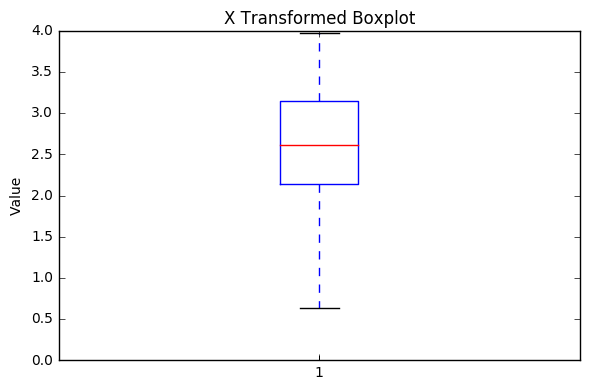

X Transformed Standardized
number of instances:  31454
minimum:  -4.1082302131
Q1:  -0.786175735337
median:  -0.041614672812
mean:  5.8191584133e-16
Q3:  0.778791532519
maximum:  2.0666507442
standard deviation:  1.0
skewness:  0.006319670918951639


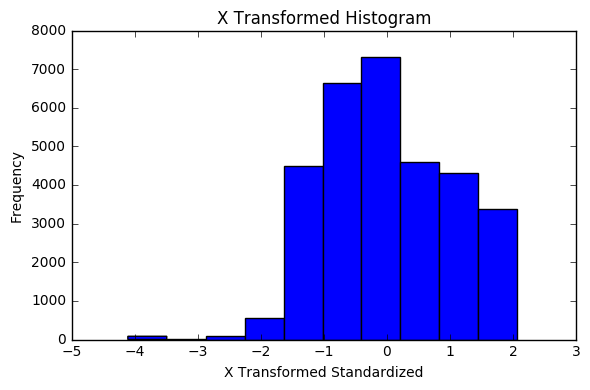

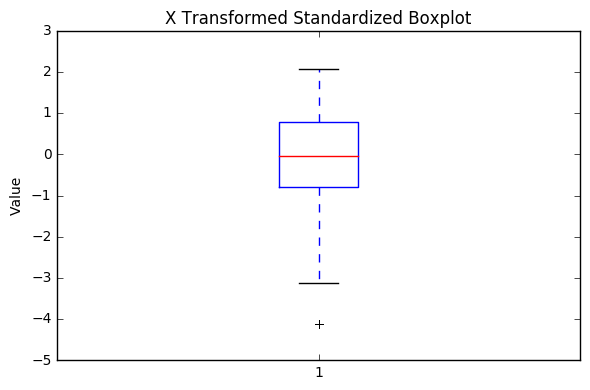

0.294661625058
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
[  7.89067884   6.51865859  10.34305842 ...,   9.3858601    0.          10.5504684 ]
[-0.25283938 -0.77822467  0.686246   ...,  0.31970774 -3.27440309
  0.76566914]
X
number of instances:  31454
minimum:  0.0
Q1:  36.0
median:  72.0
mean:  84.46909773
Q3:  119.0
maximum:  466.0
standard deviation:  58.4684941464
skewness:  1.0387969597798052


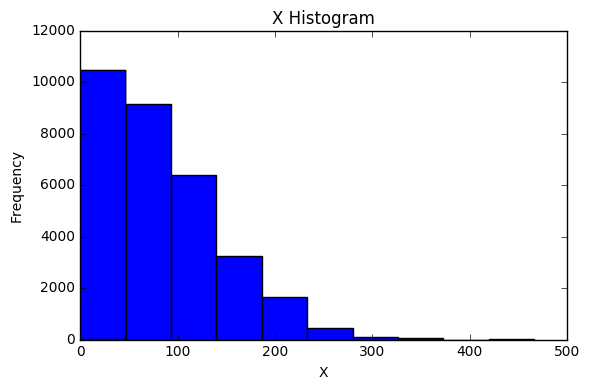

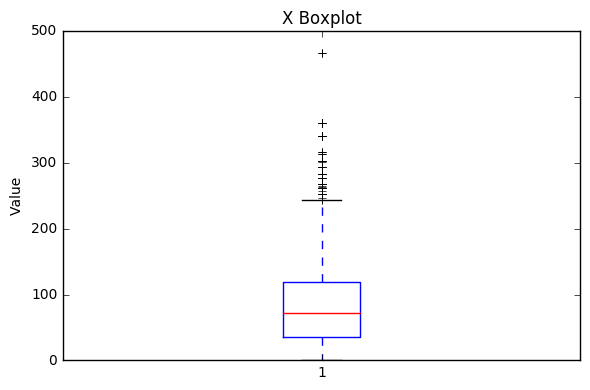

X Standardized
number of instances:  31454
minimum:  -1.44469425736
Q1:  -0.828978040868
median:  -0.213261824373
mean:  1.44575364305e-16
Q3:  0.590589902718
maximum:  6.5254101006
standard deviation:  1.0
skewness:  1.0387969597798048


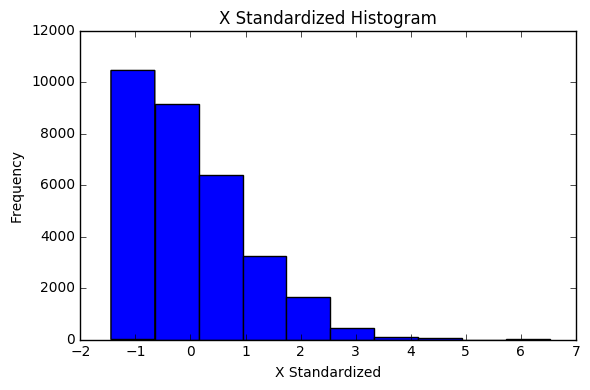

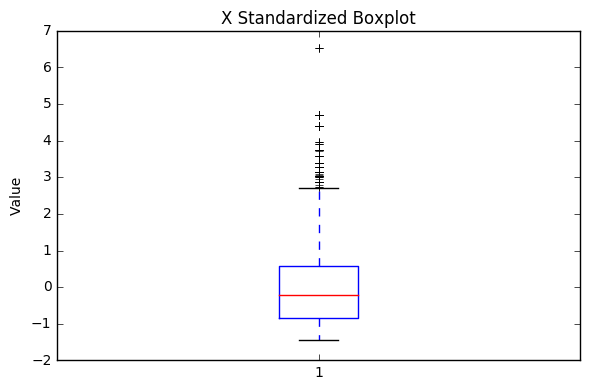

X Transformed
number of instances:  31454
minimum:  0.0
Q1:  6.44107125618
median:  8.62134281937
mean:  8.55095759344
Q3:  10.5164117827
maximum:  17.3660053123
standard deviation:  2.61145538661
skewness:  -0.04139317472700714


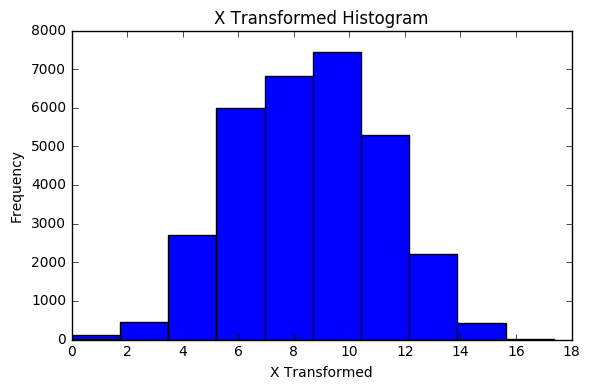

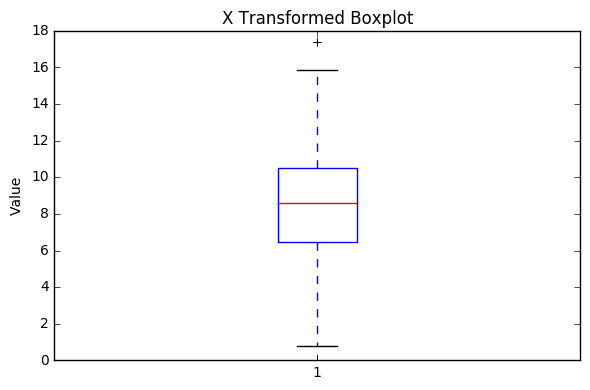

X Transformed Standardized
number of instances:  31454
minimum:  -3.27440309234
Q1:  -0.807935049579
median:  0.0269524902823
mean:  1.44575364305e-17
Q3:  0.752627902166
maximum:  3.37553065776
standard deviation:  1.0
skewness:  -0.041393174727007195


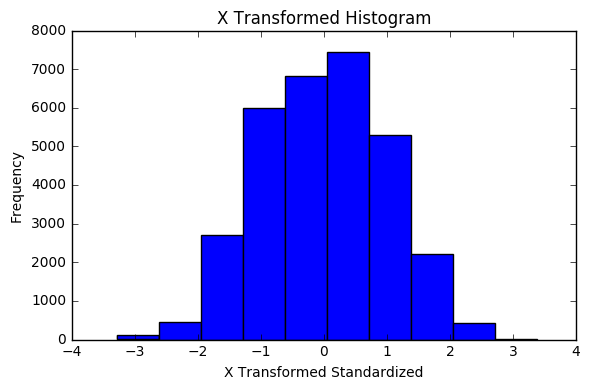

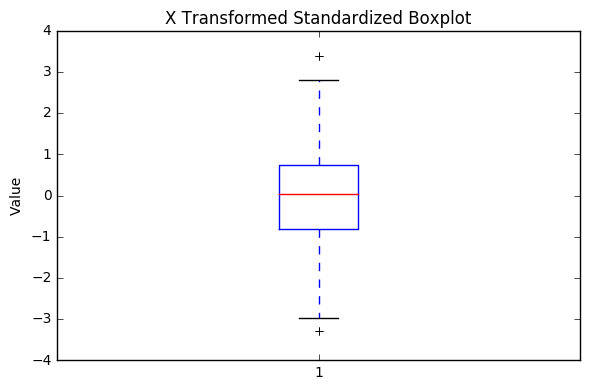

2.74814219537
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
[ 57576.32514716  64044.67773073  37629.03769549 ...,  96897.32468656
      0.              0.        ]
[-0.31271664 -0.06828491 -1.06650209 ...,  1.17317948 -2.48846089
 -2.48846089]
X
number of instances:  31454
minimum:  0.0
Q1:  71.65
median:  81.58
mean:  78.7416497107
Q3:  89.28
maximum:  100.0
standard deviation:  14.6113887199
skewness:  -1.3796780055995295


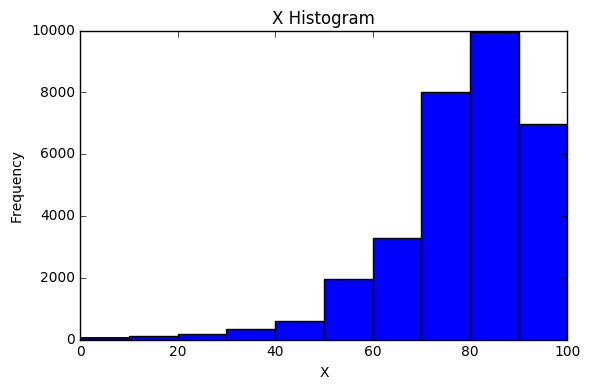

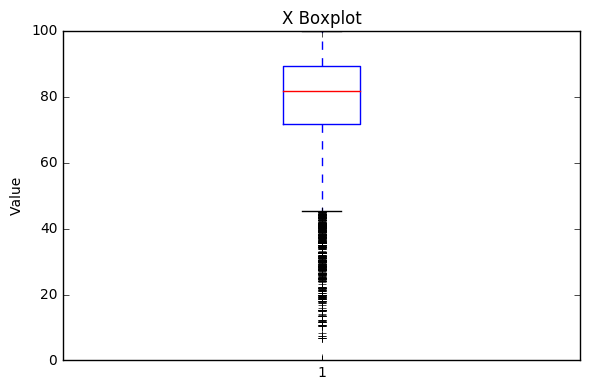

X Standardized
number of instances:  31454
minimum:  -5.38905994634
Q1:  -0.485350834657
median:  0.194256024785
mean:  -6.50589139375e-16
Q3:  0.72124220985
maximum:  1.45491648308
standard deviation:  1.0
skewness:  -1.3796780055995272


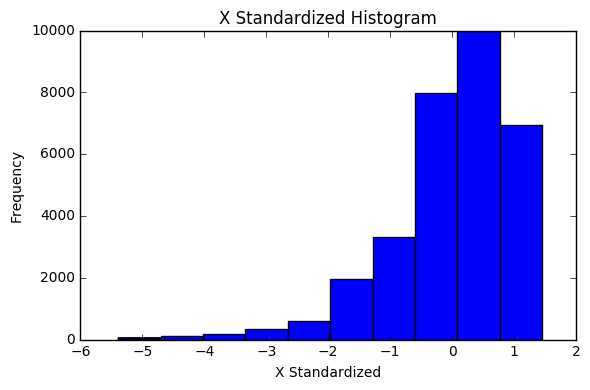

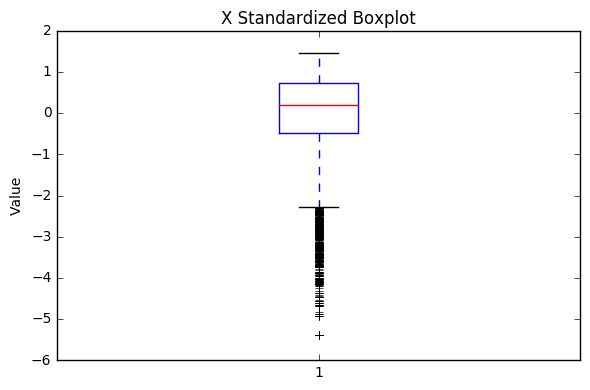

X Transformed
number of instances:  31454
minimum:  0.0
Q1:  47413.0185567
median:  67422.242401
mean:  65851.6889015
Q3:  86139.5545505
maximum:  117251.819881
standard deviation:  26462.818563
skewness:  -0.22997468979088137


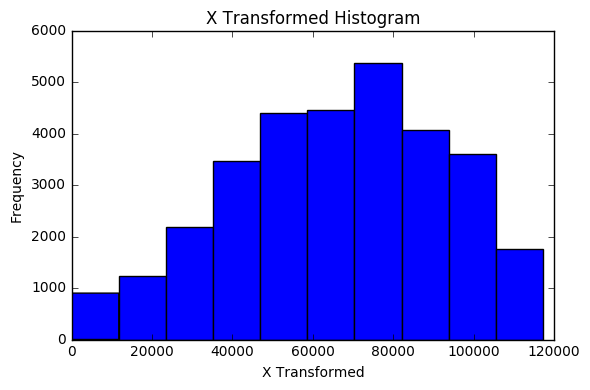

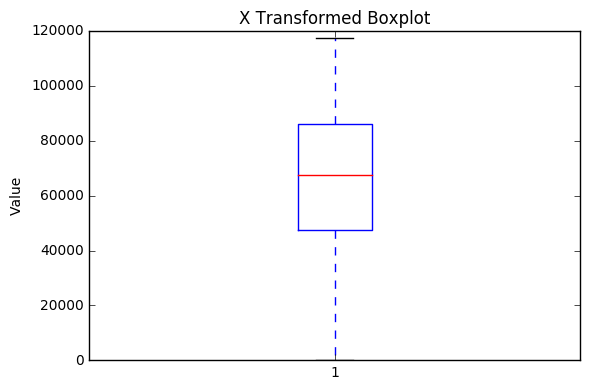

X Transformed Standardized
number of instances:  31454
minimum:  -2.48846088503
Q1:  -0.696776509309
median:  0.0593494413966
mean:  2.45778119319e-16
Q3:  0.766655509531
maximum:  1.94235284717
standard deviation:  1.0
skewness:  -0.22997468979088218


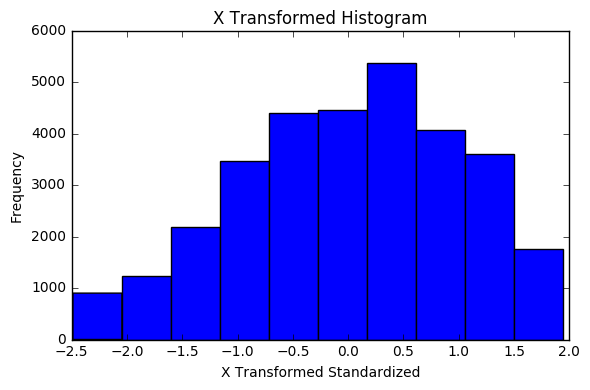

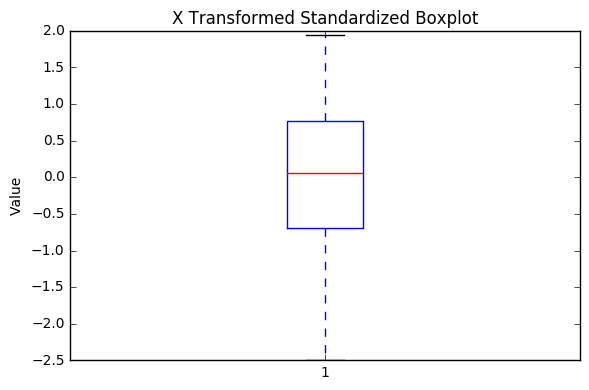

11.4044971656
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
[ 105.29445549  112.60328613   65.6092476  ...,   99.4159687     0.
   62.70208767]
[ 1.19117273  1.47973481 -0.37565051 ...,  0.95908249 -2.96598832
 -0.49042894]
X
number of instances:  31454
minimum:  -0.0
Q1:  0.767518720657
median:  0.80947865584
mean:  0.798051978649
Q3:  0.843898939786
maximum:  0.928574527856
standard deviation:  0.0625851846467
skewness:  -1.223032208839771


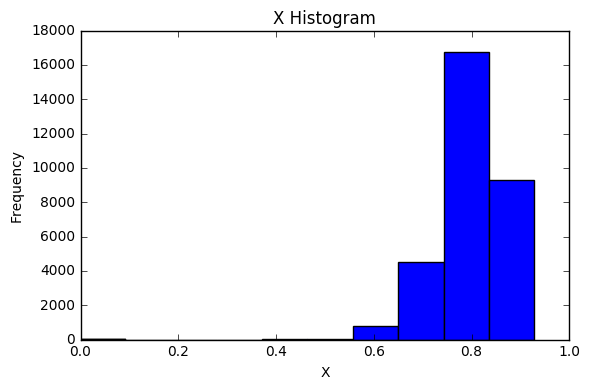

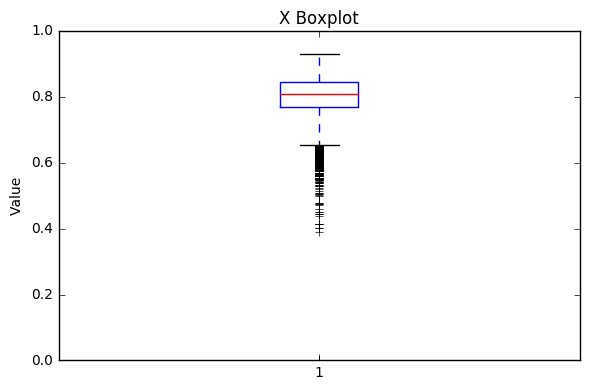

X Standardized
number of instances:  31454
minimum:  -12.7514520114
Q1:  -0.487867187165
median:  0.182577989602
mean:  4.04811020055e-16
Q3:  0.732552941975
maximum:  2.08551832105
standard deviation:  1.0
skewness:  -1.223032208839772


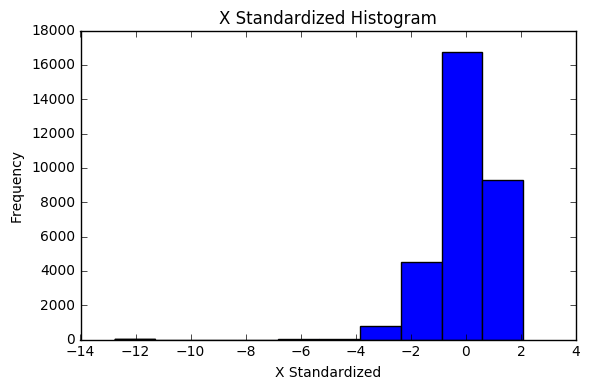

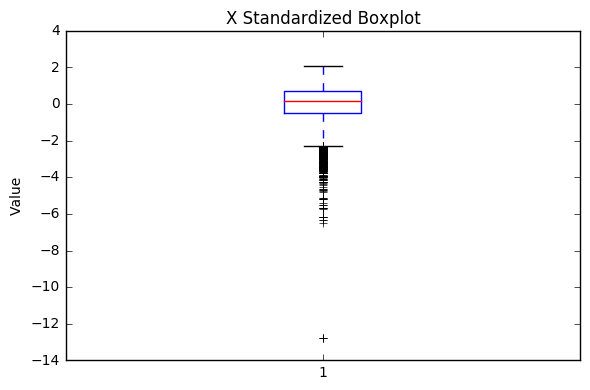

X Transformed
number of instances:  31454
minimum:  0.0
Q1:  57.9869049421
median:  75.8035495295
mean:  75.1238937329
Q3:  93.99767046
maximum:  156.913118728
standard deviation:  25.3284522747
skewness:  -0.07956778643106442


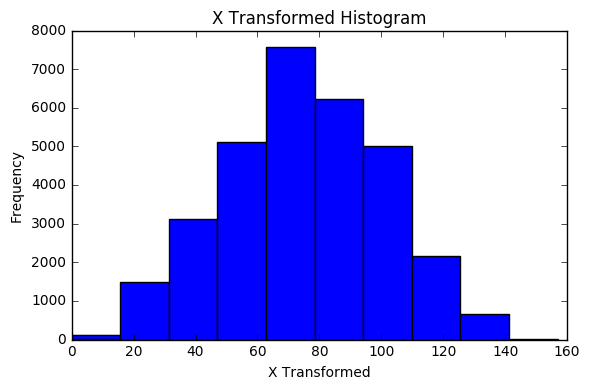

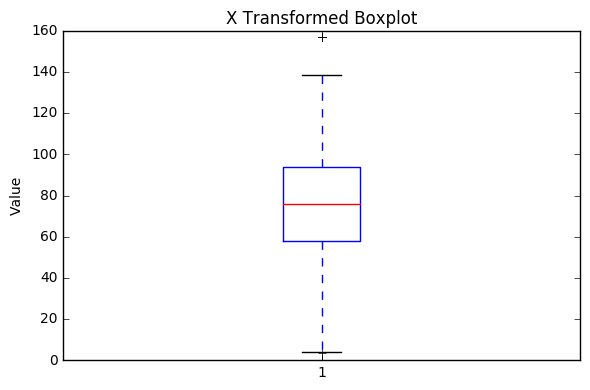

X Transformed Standardized
number of instances:  31454
minimum:  -2.96598832484
Q1:  -0.676590444809
median:  0.0268336884257
mean:  -3.90353483625e-16
Q3:  0.745161075081
maximum:  3.22914420936
standard deviation:  1.0
skewness:  -0.07956778643106309


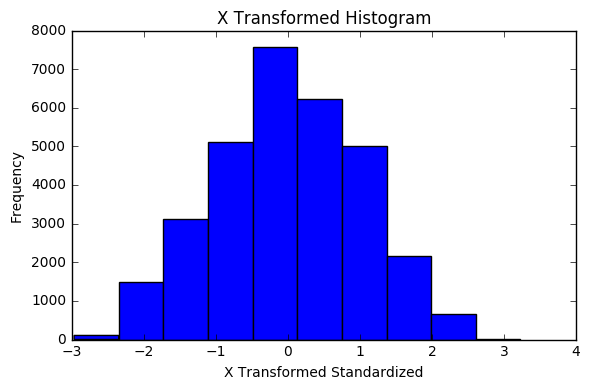

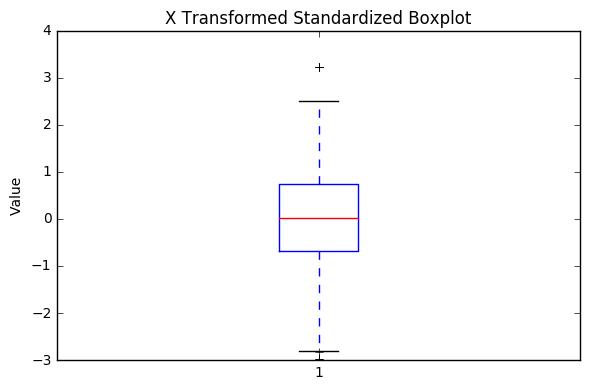

0.0686299770932
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
[ 16.93181177  18.23715717  22.40449821 ...,  15.80434841   0.          24.09796693]
[-0.12230348  0.21906741  1.30890073 ..., -0.41715507 -4.55027143
  1.75177272]
X
number of instances:  31454
minimum:  0.0
Q1:  24702.0
median:  85450.0
mean:  277622.460069
Q3:  347434.0
maximum:  2569036.0
standard deviation:  394824.510952
skewness:  1.9303897595526154


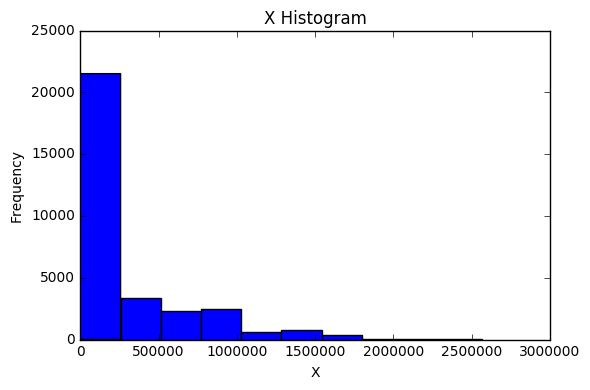

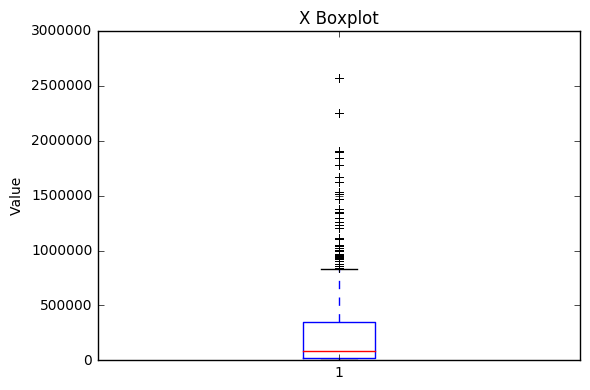

X Standardized
number of instances:  31454
minimum:  -0.703154065586
Q1:  -0.640589560813
median:  -0.486728799095
mean:  -7.22876821527e-17
Q3:  0.176816631174
maximum:  5.80362534841
standard deviation:  1.0
skewness:  1.9303897595526154


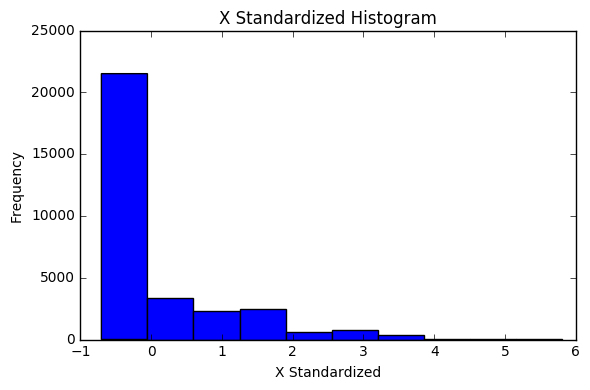

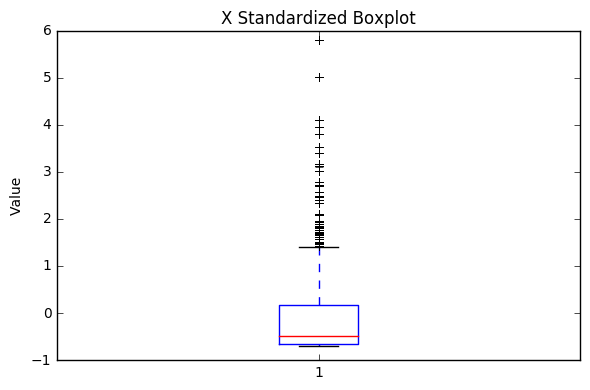

X Transformed
number of instances:  31454
minimum:  0.0
Q1:  14.6007216233
median:  17.1941751617
mean:  17.3994798988
Q3:  20.4039828503
maximum:  25.551658883
standard deviation:  3.82383340347
skewness:  -0.03197219636001762


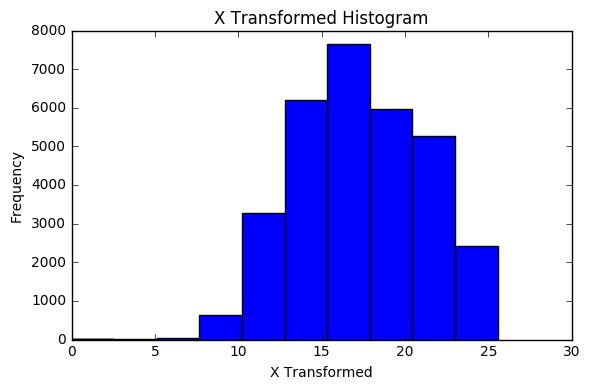

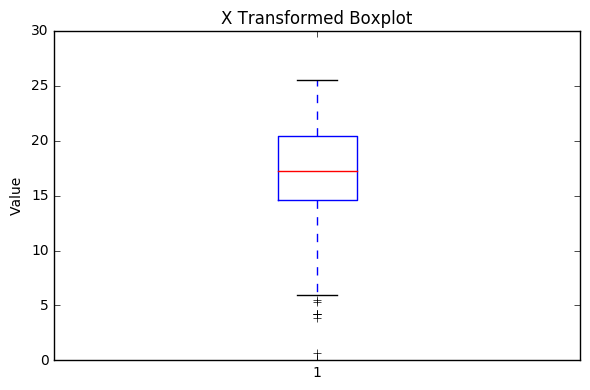

X Transformed Standardized
number of instances:  31454
minimum:  -4.55027143259
Q1:  -0.731924741527
median:  -0.0536908163621
mean:  8.09622040111e-16
Q3:  0.785730609691
maximum:  2.1319388488
standard deviation:  1.0
skewness:  -0.03197219636002021


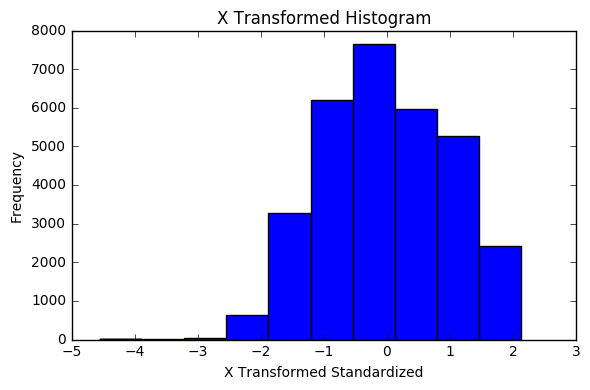

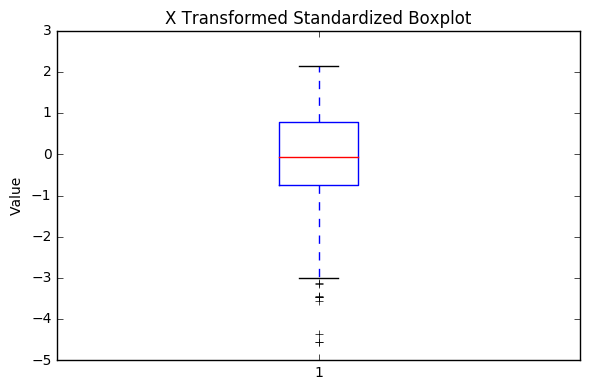

5.23630329911
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
[ 6869095.68334831  1149270.4717887   7798432.64838848 ...,
  6370016.19170551        0.          8886772.25271291]
[ 0.34535439 -2.4578177   0.80080387 ...,  0.1007655  -3.0210522
  1.33417737]
X
number of instances:  31454
minimum:  0.0
Q1:  24.9369968224
median:  26.2141578783
mean:  25.8741092332
Q3:  27.2557366061
maximum:  29.9473412
standard deviation:  2.08106180891
skewness:  -2.2566964243197143


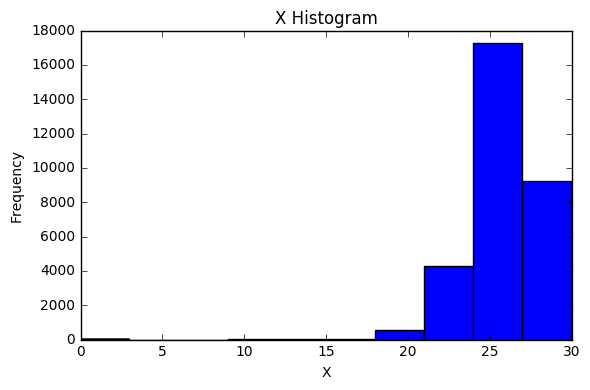

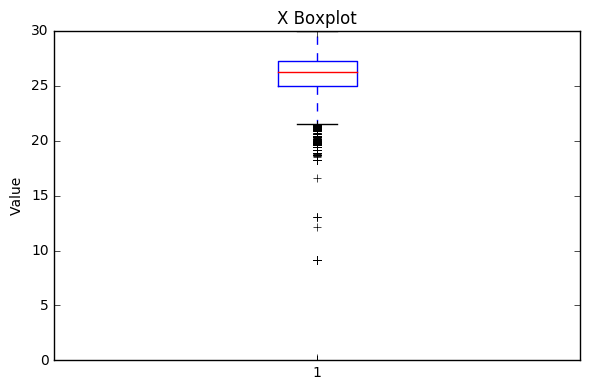

X Standardized
number of instances:  31454
minimum:  -12.4331286666
Q1:  -0.450304938929
median:  0.163401511482
mean:  -2.60597094161e-15
Q3:  0.663905015675
maximum:  1.95728543447
standard deviation:  1.0
skewness:  -2.2566964243197063


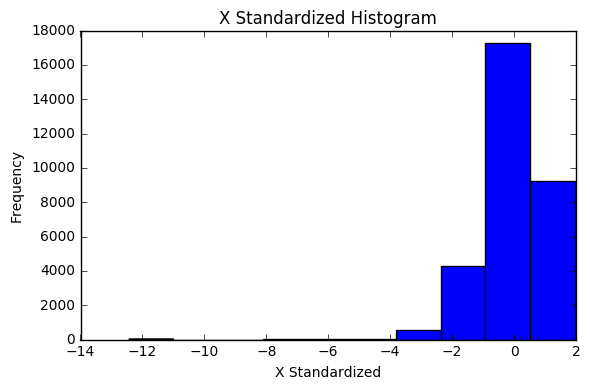

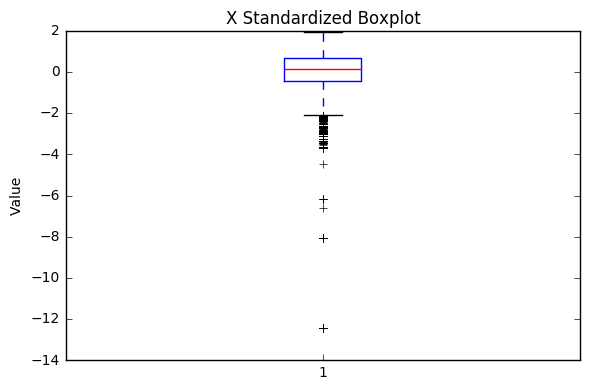

X Transformed
number of instances:  31454
minimum:  0.0
Q1:  4838241.25341
median:  6222952.13896
mean:  6164405.90069
Q3:  7575471.13125
maximum:  12199193.7396
standard deviation:  2040483.0813
skewness:  -0.10758091992856228


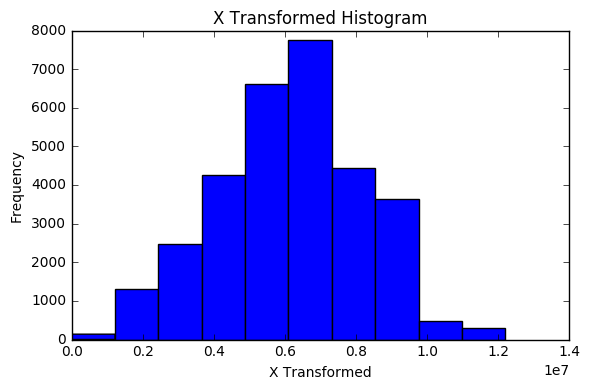

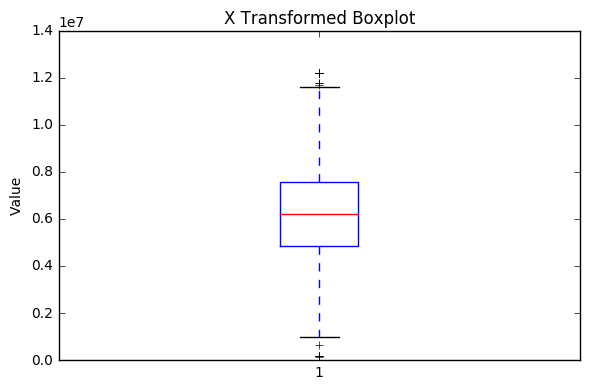

X Transformed Standardized
number of instances:  31454
minimum:  -3.02105219944
Q1:  -0.649926803822
median:  0.0286923419287
mean:  3.68667178979e-16
Q3:  0.691534883816
maximum:  2.95752897644
standard deviation:  1.0
skewness:  -0.10758091992856358


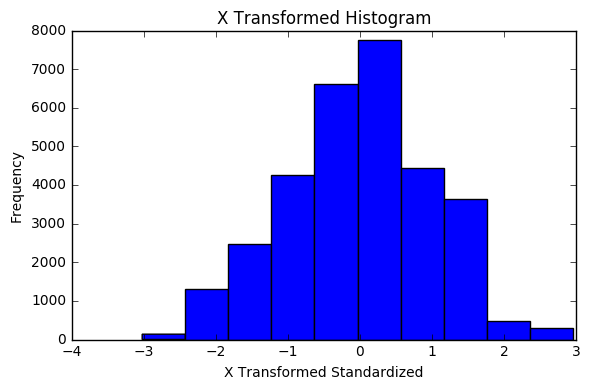

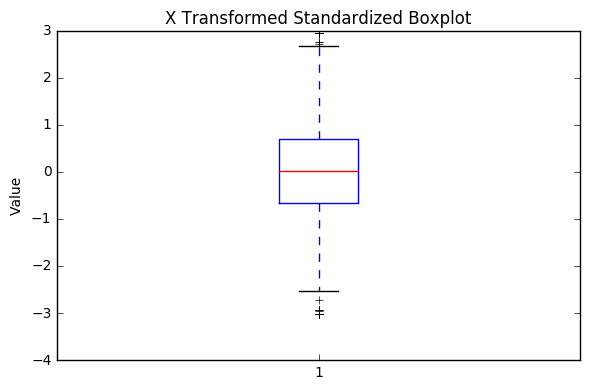

In [9]:
# census variables (objective)
data['poverty_frac_ts'] = helpers.analyse_and_transform(data['poverty_fr'].apply(helpers.mk_number))
data['black_frac_ts'] = helpers.analyse_and_transform(data['black_frac'].apply(helpers.mk_number))
data['hispanic_frac_ts'] = helpers.analyse_and_transform(data['hispanic_f'].apply(helpers.mk_number))
data['assaults_ts'] = helpers.analyse_and_transform(data['assaults_2'].apply(helpers.mk_number))
data['rented_frac_ts'] = helpers.analyse_and_transform(data['rented_fra'].apply(helpers.mk_number))

# social media variables (more subjective)
data['venues_index_ts'] = helpers.analyse_and_transform(data['venues_ind'].apply(helpers.mk_number))
data['checkins_ts'] = helpers.analyse_and_transform(data['checkins_t'].apply(helpers.mk_number))
data['avg_qscore_ts'] = helpers.analyse_and_transform(data['avg_qscore'].apply(helpers.mk_number))

*** Prepare the right data types for the regressions following ***

In [10]:
y_final = np.array(data['price_log'])
print(type(y_final))
print(y_final.shape)
y_name = 'log-transformed price'

x_final = data[[
'room_type','accomodate','bathrooms','bedroom_type',
        
'poverty_frac_ts',
'black_frac_ts',
'hispanic_frac_ts',
'assaults_ts',
'rented_frac_ts',
        
'venues_index_ts',  
'checkins_ts',
'avg_qscore_ts',
]]
print(type(x_final))
print(x_final.shape)

cols=x_final.columns.tolist()
feature_names = cols[:]
print('only features: ', feature_names)
print('dependent variable: ', y_name)

<class 'numpy.ndarray'>
(31454,)
<class 'pandas.core.frame.DataFrame'>
(31454, 12)
only features:  ['room_type', 'accomodate', 'bathrooms', 'bedroom_type', 'poverty_frac_ts', 'black_frac_ts', 'hispanic_frac_ts', 'assaults_ts', 'rented_frac_ts', 'venues_index_ts', 'checkins_ts', 'avg_qscore_ts']
dependent variable:  log-transformed price


** Test correlations of dependent variable with the independent variables **

In [12]:
## lets have a look at the Pearson correlations to understand whether there are any strong relationships
X = np.array(x_final)
Xy = np.vstack((X.T, np.atleast_2d(y_final)))
#print(Xy)

correlations = np.corrcoef(Xy)[-1, :]
c = 0 
for feature_name, correlation in zip(feature_names, correlations):
    p = float(sp.stats.pearsonr(X[0:,c], y_final)[1])
    if (p <= 0.001):
        print (c, '{0:>10} {1:+.4f}'.format(feature_name, correlation), '***'.format(p))
    else:
        if (p <= 0.01):
            print (c, '{0:>10} {1:+.4f}'.format(feature_name, correlation), '**'.format(p))
        else:
            if (p <= 0.05):
                print (c, '{0:>10} {1:+.4f}'.format(feature_name, correlation), '*'.format(p))
            else:
                print ('NOT'.format(p), c, '{0:>10} {1:+.4f}'.format(feature_name, correlation))#, '(p={0:+.4f})'.format(p)
    c+=1
print('{0:>10} {1:+.4f}'.format('y', correlations[-1]))

0  room_type +0.6605 ***
1 accomodate +0.5642 ***
2  bathrooms +0.1966 ***
3 bedroom_type +0.1000 ***
4 poverty_frac_ts -0.3046 ***
5 black_frac_ts -0.2577 ***
6 hispanic_frac_ts -0.3050 ***
7 assaults_ts -0.1046 ***
8 rented_frac_ts -0.1124 ***
9 venues_index_ts +0.1554 ***
10 checkins_ts +0.4643 ***
11 avg_qscore_ts +0.0675 ***
         y +1.0000


** Build proximity matrix (this time based on nearest neighbors) **

In [13]:
airbnbW = ps.knnW_from_shapefile(airbnb_shp_link, k=10)

**Test for global spatial auto-correlation**

In [14]:
I = ps.Moran(y_final, airbnbW)
I.I, I.p_sim

(0.33120102272331814, 0.001)

**Finally, build the models. Start with simple OLS and diagnostics.**

In [15]:
airbnb_model_ols = ps.spreg.OLS(y=y_final[:, None], \
                         x=x_final.values, \
                         w=airbnbW, \
                         name_y=y_name, \
                         name_x=feature_names, \
                         spat_diag=True)
print(airbnb_model_ols.summary)

REGRESSION
----------
SUMMARY OF OUTPUT: ORDINARY LEAST SQUARES
-----------------------------------------
Data set            :     unknown
Weights matrix      :     unknown
Dependent Variable  :log-transformed price                Number of Observations:       31454
Mean dependent var  :      4.7136                Number of Variables   :          13
S.D. dependent var  :      0.6401                Degrees of Freedom    :       31441
R-squared           :      0.6609
Adjusted R-squared  :      0.6608
Sum squared residual:    4370.039                F-statistic           :   5106.5160
Sigma-square        :       0.139                Prob(F-statistic)     :           0
S.E. of regression  :       0.373                Log likelihood        :  -13590.059
Sigma-square ML     :       0.139                Akaike info criterion :   27206.119
S.E of regression ML:      0.3727                Schwarz criterion     :   27314.751

--------------------------------------------------------------------

***Continue with spatial models (which one?)***

In [16]:
airbnb_model_combo = ps.spreg.GM_Combo(y=y_final[:, None], \
                         x=x_final.values, \
                         w=airbnbW, \
                         name_y=y_name, \
                         name_x=feature_names)
print(airbnb_model_combo.summary)

REGRESSION
----------
SUMMARY OF OUTPUT: SPATIALLY WEIGHTED TWO STAGE LEAST SQUARES
-------------------------------------------------------------
Data set            :     unknown
Weights matrix      :     unknown
Dependent Variable  :log-transformed price                Number of Observations:       31454
Mean dependent var  :      4.7136                Number of Variables   :          14
S.D. dependent var  :      0.6401                Degrees of Freedom    :       31440
Pseudo R-squared    :      0.6769
Spatial Pseudo R-squared:  0.6637

------------------------------------------------------------------------------------
            Variable     Coefficient       Std.Error     z-Statistic     Probability
------------------------------------------------------------------------------------
            CONSTANT       2.8578782       0.0595468      47.9938566       0.0000000
           room_type       0.5076191       0.0049858     101.8133889       0.0000000
          accomodate       0

*** Asses prediction performance of spatial models***

In [17]:
from sklearn.metrics import mean_squared_error as mse

mses = pd.Series({'OLS': mse(y_final, airbnb_model_ols.predy.flatten()), \
                  'Combo': mse(y_final, airbnb_model_combo.predy.flatten())
                    })
mses.sort_values()

Combo    0.132390
OLS      0.138934
dtype: float64